# Libraries

In [1]:
import os
import time
from datetime import datetime

import numpy as np
import pandas as pd
import plotly.express as px
import plotly.io as pio
from plotly.subplots import make_subplots
import plotly.subplots as sp
import plotly.graph_objects as go
import plotly.figure_factory as ff
import seaborn as sns
from dateutil import parser
from google.cloud import bigquery
from IPython.display import display, HTML
from plotly.io import to_html
import matplotlib.pyplot as plt
import statsmodels.api as sm
from sklearn.preprocessing import PolynomialFeatures
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
import plotly.io as pio


In [2]:
def bq_run(query):
    query_job = client.query(query)
    return query_job.to_dataframe()

def load_or_run_query(csv_path, sql_path):
    
    if os.path.exists(csv_path):
        df = pd.read_csv(csv_path)
        print(f"Loaded DataFrame from {csv_path}")
    else:
        with open(sql_path, 'r') as file:
            query = file.read()

        df = bq_run(query)
        df.to_csv(csv_path, index=False)
        print(f"Saved DataFrame to {csv_path}")

    return df

In [3]:
client = bigquery.Client(project="fever-data-prod")

In [4]:
def histogram(title, x_axis_title, y_axis_title, metric, type=False, limit=None, df_plot=None):

    if df_plot is None:
        df_plot = df
    
    df_plot['event_date'] = pd.to_datetime(df['event_date'])
    filtered_df = df[df['event_date'] != pd.to_datetime(datetime.now().date())]
    
    if limit != None:
        filtered_df = df_plot[df_plot[metric] <= limit]

    if type:
        df_plot = filtered_df.groupby(['external_id', 'charger_type'])[metric].mean().reset_index()
        fig = px.histogram(df_plot, x=metric, nbins=25, title=title, color="charger_type")
    else:
        df_plot = filtered_df.groupby(['external_id'])[metric].mean().reset_index()
        fig = px.histogram(df_plot, x=metric, nbins=25, title=title)
        
    fig.update_traces(hovertemplate=f'<b>{y_axis_title}</b>: %{{y}}<br><b>{x_axis_title}</b>: %{{x}}')
    
    fig.update_layout(
        xaxis_title=x_axis_title,
        yaxis_title=y_axis_title,
        width=1000,
        height=500,
        template='plotly_white',
        title_font=dict(size=20, family='Arial', color='darkblue'),
        xaxis=dict(
            title=dict(font=dict(size=16)),
            tickfont=dict(size=14),
        ),
        yaxis=dict(
            title=dict(font=dict(size=16)),
            tickfont=dict(size=14),
        )
    )
    
    fig.show()

In [5]:
def lineplot(title, x_axis_title, y_axis_title, metric, y_axis_upper_limit=None, y_axis_lower_limit=None, full_series=True, df_plot=None, group=None):

    if df_plot is None:
        df_plot = df
    
    if full_series:
        df_plot['event_date'] = pd.to_datetime(df_plot['event_date'])
        filtered_df = df_plot[df_plot['event_date'] != pd.to_datetime(datetime.now().date())]


        print(f"GROUP {group}")

        if group:
            filtered_df = filtered_df.groupby(['event_date', group])[metric].mean().reset_index()
            fig = px.line(filtered_df, x='event_date', y=metric, title=title, color=group)
        else:
            filtered_df = filtered_df.groupby('event_date')[metric].mean().reset_index()
            fig = px.line(filtered_df, x='event_date', y=metric, title=title)
    else:
        filtered_df = df_plot
        filtered_df = filtered_df.groupby(['time'])[metric].mean().reset_index()
        fig = px.line(filtered_df, x='time', y=metric, title=title)
    
    fig.update_traces(hovertemplate=f'<b>{y_axis_title}</b>: %{{y}}<br><b>{x_axis_title}</b>: %{{x}}')
    
    fig.update_layout(
        xaxis_title=x_axis_title,
        yaxis_title=y_axis_title,
        width=1000,
        height=500,
        template='plotly_white',
        title_font=dict(size=20, family='Arial', color='darkblue'),
        xaxis=dict(
            title_font=dict(size=16),
            tickfont=dict(size=14),
        ),
        yaxis=dict(
            title_font=dict(size=16),
            tickfont=dict(size=14),
        ),
        yaxis_range=[y_axis_lower_limit, y_axis_upper_limit] if y_axis_lower_limit is not None and y_axis_upper_limit is not None else None
    )
    
    fig.show()

# Questions

### Data Cleaning
#### Outliers
- Criterion: Charging session > 20 hours/day
- **Result**: 2 out of 2250 chargers logged charging sessions > 20 hours/day
#### Inactive Chargers
- **Result**: 240 out of 2250 chargers are inactive (10.7%)
### Capacity Planning
#### Minimum Number of Chargers Needed
- On average the hourly charging power is 5.4 kW.
- On average 11% of the fleet is actively charging.
- **Result based on above data**:
  * 230 chargers needed to place 100 kW hourly bids (average)
  * 115 chargers needed to be able to place 20% of all hourly bids
  * 345 chargers needed to be able to place 80% of all hourly bids
### Charging Patterns
#### Frequency of Use
##### Sessions ≥ 10s
- Chargers with avg time between sessions ≤ 24 hours: 80.04%
- Chargers with avg time between sessions ≤ 72 hours: 97.87%
##### Sessions ≥ 5min
- Chargers with avg time between sessions ≤ 24 hours: 78.82%
- Chargers with avg time between sessions ≤ 72 hours: 97.05%
##### Sessions ≥ 30min
- Chargers with avg time between sessions ≤ 24 hours: 75.93%
- Chargers with avg time between sessions ≤ 72 hours: 95.28%
#### Time of Day Preferences
- **Maximum**: 21:00 - 01:00
- **Minimum**: 05:00 - 07:00
### Charging Metrics
#### Hours Charged per Day
- **Overall**: 2.03 (Total chargers: 2250)
- **easee**: 1.95 (Chargers: 1067)
- **zaptec**: 2.12 (Chargers: 1183)
#### Average Session Duration (hours)
- **Overall**: 1.4 (Total chargers: 2250)
- **easee**: 1.17 (Chargers: 1067)
- **zaptec**: 1.6 (Chargers: 1183)
#### Average Charging Sessions per Day
- **Overall**: 2.38 (Total chargers: 2250)
- **easee**: 2.92 (Chargers: 1067)
- **zaptec**: 1.85 (Chargers: 1183)
#### Average Hourly Charging Power
- **Overall**: 5.4 kW (range: 4 kW - 6.5 kW)
- Minimum: 4 kWh at 04:00
- Maximum: 6 kWh at 22:00
### Charger Performance
#### Non-Responsive Chargers to Start/Stop Commands
- **Stop Commands**
  - easee: 8%
  - zaptec: 10%
- **Start Commands**
  - easee: 19%
  - zaptec: 10%
### Reason In Start/Stop Commands
- 28% have reason set to 'removeBisbehavingCharger'.
- Make smarter decisions about which chargers to pick (or not pick)
#### Command Reaction Speed
- **Stop Commands (median)**
  - easee: 1.2s
  - zaptec: 2.6s
- **Start Commands (median)**
  - easee: 12.2s
  - zaptec: 20.7s
#### Charging Speed Analysis
### Further Analysis (To Be Conducted)
#### Charging Performance
- Charging hours distribution
- Stability of charging metrics
#### Clustering / User Segmentation
- Cluster chargers based on usage patterns
- Identify:
  - Home users
  - Office users
  - Outliers/Unique cases
  - High performing chargers
  - Low performing chargers

# Charger Metrics Data Cleaning

## Check Outliers that Charge > 20 h/day

In [6]:
q = '''

WITH
  charging_events AS (
  SELECT
    ds.external_id,
    ds.event_publish_time,
    ds.charge_power,
    LEAD(ds.event_publish_time) OVER (PARTITION BY ds.external_id ORDER BY ds.event_publish_time) AS next_event_time,
    DATE(ds.event_publish_time) AS event_date,
    TIMESTAMP_DIFF(LEAD(ds.event_publish_time) OVER (PARTITION BY ds.external_id ORDER BY ds.event_publish_time), ds.event_publish_time, MILLISECOND) / 1000.0 AS duration_seconds
  FROM
    `fever-data-prod.fever.device_state` ds
  INNER JOIN
    `fever-data-prod.fever.assets` a
  ON
    ds.asset_id = a.id
  WHERE
    a.organization_id = '90d4188b-f6e6-4150-93d9-c3e23610d084'
    AND ds.event_publish_time >= '2024-05-15 00:00:00'
    AND ds.event_publish_time < '2024-06-01 00:00:00'
    AND a.id IN ('98b95ea6-16e8-45de-83b1-f5676d373e8d') -- SE3 bidding zone
    ),
  daily_charging_hours AS (
  SELECT
    external_id,
    event_date,
    SUM(CASE
        WHEN charge_power > 0 THEN duration_seconds
        ELSE 0
    END
      ) / 3600.0 AS charging_hours
  FROM
    charging_events
  GROUP BY
    external_id,
    event_date ),

  categorized_chargers AS (
    SELECT
      external_id,
      MAX(CASE WHEN charging_hours > 20 THEN 1 ELSE 0 END) AS is_outlier
    FROM
      daily_charging_hours
    GROUP BY
      external_id
  )

SELECT
  COUNT(DISTINCT CASE WHEN is_outlier = 1 THEN external_id END) AS outlier_chargers,
  COUNT(DISTINCT CASE WHEN is_outlier = 0 THEN external_id END) AS non_outlier_chargers
FROM
  categorized_chargers

'''

df_outliers = bq_run(q)
df_outliers

,outlier_chargers,non_outlier_chargers
0,2,2248


## Check Very Short Charging Sessions

In [47]:
q = '''

WITH charging_events AS (
  SELECT
    ds.external_id,
    ds.event_publish_time,
    ds.charge_power,
    ds.type,
    DATE(ds.event_publish_time) AS event_date,
    TIMESTAMP_DIFF(LEAD(ds.event_publish_time) OVER (PARTITION BY ds.external_id ORDER BY ds.event_publish_time), ds.event_publish_time, MILLISECOND) / 1000.0 AS duration_seconds
  FROM `fever-data-prod.fever.device_state` ds
  INNER JOIN `fever-data-prod.fever.assets` a ON ds.asset_id = a.id
  WHERE a.organization_id = '90d4188b-f6e6-4150-93d9-c3e23610d084'
    AND ds.event_publish_time >= '2024-05-15 00:00:00'
    AND ds.event_publish_time < '2024-06-01 00:00:00'
    AND a.id IN ('98b95ea6-16e8-45de-83b1-f5676d373e8d') -- SE3 bidding zone
),
session_starts AS (
  SELECT
    external_id,
    event_date,
    event_publish_time,
    charge_power,
    duration_seconds,
    type,
    CASE
      WHEN charge_power > 0 AND LAG(charge_power) OVER (PARTITION BY external_id ORDER BY event_publish_time) <= 0 THEN 1
      ELSE 0
    END AS is_session_start
  FROM charging_events
),
charging_sessions AS (
  SELECT
    external_id,
    event_date,
    event_publish_time,
    charge_power,
    duration_seconds,
    type,
    SUM(is_session_start) OVER (PARTITION BY external_id ORDER BY event_publish_time) AS session_id
  FROM session_starts
),
session_summaries AS (
  SELECT
    external_id,
    event_date,
    session_id,
    type,
    SUM(CASE WHEN charge_power > 0 THEN duration_seconds ELSE 0 END) AS session_duration,
    MAX(charge_power) AS max_charge_power,
    STDDEV(charge_power) AS power_stddev  -- Added standard deviation of charge power
  FROM charging_sessions
  GROUP BY external_id, event_date, session_id, type
),
session_duration_distribution AS (
  SELECT
    FLOOR(session_duration) AS session_duration,
    type,
    COUNT(*) AS session_count,
    AVG(power_stddev) AS avg_power_stddev  -- Added average power standard deviation
  FROM session_summaries
  WHERE session_duration > 0
  GROUP BY FLOOR(session_duration), type
),
total_sessions AS (
  SELECT type, SUM(session_count) AS total_count
  FROM session_duration_distribution
  GROUP BY type
),
cumulative_distribution AS (
  SELECT
    sdd.session_duration,
    sdd.type,
    sdd.session_count,
    sdd.avg_power_stddev,  -- Include average power standard deviation
    SUM(sdd.session_count) OVER (PARTITION BY sdd.type ORDER BY sdd.session_duration) AS cumulative_count,
    ts.total_count
  FROM session_duration_distribution sdd
  JOIN total_sessions ts ON sdd.type = ts.type
)
SELECT
  session_duration,
  type,
  session_count,
  cumulative_count,
  total_count,
  (cumulative_count / total_count) * 100 AS cumulative_percentage,
  avg_power_stddev  -- Include average power standard deviation in final output
FROM cumulative_distribution
ORDER BY type, session_duration

'''

df_distribution = bq_run(q)

In [48]:
df_distribution.to_csv('df_distribution.csv')
#df_distribution = pd.read_csv('df_agg_1h_1d_2w_metrics.csv')
df_distribution.head()

,session_duration,type,session_count,cumulative_count,total_count,cumulative_percentage,avg_power_stddev
0,0.0,easee,2163,2163,51856,4.171166,875.935465
1,1.0,easee,1157,3320,51856,6.402345,379.031622
2,2.0,easee,1002,4322,51856,8.334619,284.619891
3,3.0,easee,1002,5324,51856,10.266893,301.406688
4,4.0,easee,2260,7584,51856,14.625116,500.985493


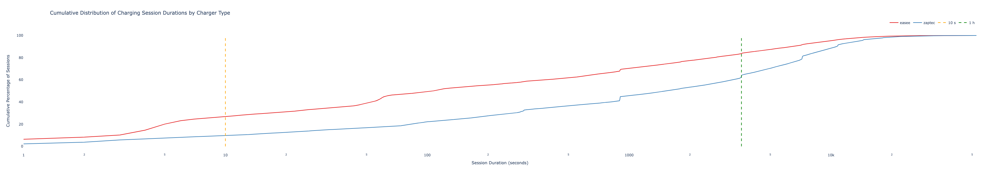

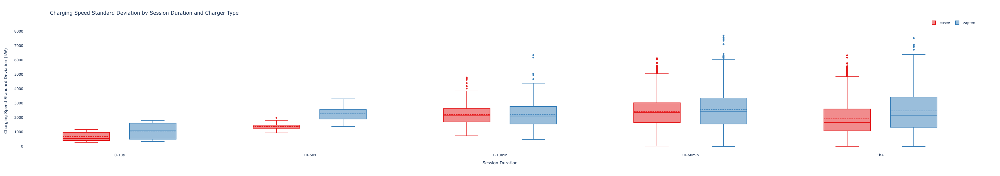

In [49]:
duration_bins = [0, 10, 60, 600, 3600, float('inf')]
duration_labels = ['0-10s', '10-60s', '1-10min', '10-60min', '1h+']


df_distribution['duration_bin'] = pd.cut(df_distribution['session_duration'], bins=duration_bins, labels=duration_labels, include_lowest=True)
colors = px.colors.qualitative.Set1
fig1 = go.Figure()

for i, charger_type in enumerate(df_distribution['type'].unique()):
    df_type = df_distribution[df_distribution['type'] == charger_type]
    fig1.add_trace(go.Scatter(
        x=df_type['session_duration'],
        y=df_type['cumulative_percentage'],
        mode='lines',
        name=f'{charger_type}',
        line=dict(color=colors[i])
    ))


for threshold, color, name in [(10, 'orange', '10 s'), 
                               (3600, 'green', '1 h')]:
    fig1.add_trace(go.Scatter(
        x=[threshold, threshold],
        y=[0, 100],
        mode='lines',
        name=name,
        line=dict(color=color, dash='dash')
    ))

fig1.update_layout(
    title='Cumulative Distribution of Charging Session Durations by Charger Type',
    xaxis_title='Session Duration (seconds)',
    yaxis_title='Cumulative Percentage of Sessions',
    xaxis_type="log",
    height=600,
    width=1200,
    plot_bgcolor='white',
    paper_bgcolor='white',
    legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1)
)


fig2 = go.Figure()

for i, charger_type in enumerate(df_distribution['type'].unique()):
    df_type = df_distribution[df_distribution['type'] == charger_type]
    fig2.add_trace(go.Box(
        x=df_type['duration_bin'],
        y=df_type['avg_power_stddev'],
        name=f'{charger_type}',
        marker_color=colors[i],
        boxmean=True  # adds a marker for the mean
    ))

fig2.update_layout(
    title='Charging Speed Standard Deviation by Session Duration and Charger Type',
    xaxis_title='Session Duration',
    yaxis_title='Charging Speed Standard Deviation (kW)',
    height=600,
    width=1200,
    plot_bgcolor='white',
    paper_bgcolor='white',
    legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1),
    boxmode='group'  # This ensures boxes are grouped side by side
)

fig2.update_xaxes(type="category", categoryorder='array', categoryarray=duration_labels)

fig1.show()
fig2.show()

In [784]:
df_distribution.groupby('type')['avg_power_stddev'].describe()

,count,mean,std,min,25%,50%,75%,max
type,,,,,,,,
easee,9065.0,2083.094504,1115.085753,6.524936,1254.298828,1913.370263,2786.827844,6338.486550
zaptec,9120.0,2482.055254,1349.575544,2.162545,1404.932556,2242.884710,3361.011449,7713.720396


# Charger Metrics Aggregated (Greenely, S3, May 15 - May 31)

In [55]:
q = '''

WITH charging_events AS (
  SELECT
    ds.external_id,
    ds.event_publish_time,
    ds.charge_power,
    LEAD(ds.event_publish_time) OVER (PARTITION BY ds.external_id ORDER BY ds.event_publish_time) AS next_event_time,
    DATE(ds.event_publish_time) AS event_date,
    TIMESTAMP_DIFF(LEAD(ds.event_publish_time) OVER (PARTITION BY ds.external_id ORDER BY ds.event_publish_time), ds.event_publish_time, MILLISECOND) / 1000.0 AS duration_seconds,
    CASE WHEN ds.charge_power > 0 AND LAG(ds.charge_power) OVER (PARTITION BY ds.external_id ORDER BY ds.event_publish_time) <= 0 THEN 1 ELSE 0 END AS session_start
  FROM `fever-data-prod.fever.device_state` ds
  INNER JOIN `fever-data-prod.fever.assets` a ON ds.asset_id = a.id
  WHERE a.organization_id = '90d4188b-f6e6-4150-93d9-c3e23610d084'
    AND ds.event_publish_time >= '2024-05-15 00:00:00'
    AND ds.event_publish_time < '2024-06-01 00:00:00'
    AND a.id IN ('98b95ea6-16e8-45de-83b1-f5676d373e8d') -- SE3 bidding zone
),

charging_sessions AS (
  SELECT
    external_id,
    event_publish_time,
    charge_power,
    next_event_time,
    event_date,
    duration_seconds,
    SUM(session_start) OVER (PARTITION BY external_id ORDER BY event_publish_time) AS session_id
  FROM charging_events
),

filtered_charging_sessions AS (
  SELECT
    external_id,
    event_date,
    session_id,
    MIN(event_publish_time) AS session_start_time,
    MAX(next_event_time) AS session_end_time,
    SUM(CASE WHEN charge_power > 0 THEN duration_seconds ELSE 0 END) AS session_duration_seconds
  FROM charging_sessions
  GROUP BY external_id, event_date, session_id
  HAVING session_duration_seconds >= 10
),

daily_charging_hours AS (
  SELECT
    external_id,
    event_date,
    SUM(session_duration_seconds) / 3600.0 AS charging_hours
  FROM filtered_charging_sessions
  GROUP BY external_id, event_date
),

filtered_chargers AS (
  SELECT external_id
  FROM daily_charging_hours
  GROUP BY external_id
  HAVING MAX(charging_hours) < 20
),

daily_charger_count AS (
  SELECT
    fcs.event_date,
    COUNT(DISTINCT fcs.external_id) AS total_chargers_daily
  FROM filtered_charging_sessions fcs
  INNER JOIN filtered_chargers fc ON fcs.external_id = fc.external_id
  GROUP BY fcs.event_date
),
hourly_charger_stats AS (
  SELECT
    DATE_TRUNC(cs.event_publish_time, HOUR) AS hour,
    cs.event_date,
    cs.external_id,
    MAX(cs.charge_power) AS max_charge_power,
    SUM(CASE
      WHEN cs.charge_power > 0 THEN 
        TIMESTAMP_DIFF(
          LEAST(TIMESTAMP_ADD(DATE_TRUNC(cs.event_publish_time, HOUR), INTERVAL 1 HOUR), cs.next_event_time),
          cs.event_publish_time,
          MILLISECOND
        ) / 1000.0
      ELSE 0
    END) AS active_seconds,
    SUM(CASE
      WHEN cs.charge_power > 0 THEN 
        cs.charge_power * TIMESTAMP_DIFF(
          LEAST(TIMESTAMP_ADD(DATE_TRUNC(cs.event_publish_time, HOUR), INTERVAL 1 HOUR), cs.next_event_time),
          cs.event_publish_time,
          MILLISECOND
        ) / 1000.0
      ELSE 0
    END) AS power_second_sum
  FROM charging_sessions cs
  INNER JOIN filtered_chargers fc ON cs.external_id = fc.external_id
  INNER JOIN filtered_charging_sessions fcs ON cs.external_id = fcs.external_id AND cs.session_id = fcs.session_id
  WHERE TIMESTAMP_DIFF(cs.next_event_time, cs.event_publish_time, MILLISECOND) / 1000.0 <= 3600
  GROUP BY hour, event_date, external_id
),

hourly_metrics AS (
  SELECT
    h.hour,
    d.total_chargers_daily,
    COUNT(DISTINCT h.external_id) AS total_chargers_hourly,
    COUNT(DISTINCT CASE WHEN h.max_charge_power > 0 AND h.active_seconds > 0 THEN h.external_id END) AS active_chargers,
    ROUND(COUNT(DISTINCT CASE WHEN h.max_charge_power > 0 AND h.active_seconds > 0 THEN h.external_id END) / d.total_chargers_daily * 100, 2) AS active_chargers_pct,
    ROUND(SUM(h.power_second_sum) / NULLIF(SUM(h.active_seconds), 0) / 1000, 2) AS avg_charge_power_kw,
    SUM(h.active_seconds) / COUNT(DISTINCT CASE WHEN h.max_charge_power > 0 AND h.active_seconds > 0 THEN h.external_id END) / 3600 * 100 AS pct_charge_time_per_charger,
    ROUND(AVG(h.active_seconds) / 60, 2) AS avg_charge_time_minutes
  FROM hourly_charger_stats h
  JOIN daily_charger_count d ON h.event_date = d.event_date
  GROUP BY h.hour, d.total_chargers_daily
),

daily_metrics AS (
  SELECT
    DATE(hour) AS event_date,
    MIN(avg_charge_power_kw) AS min_avg_charge_power_kw,
    MAX(avg_charge_power_kw) AS max_avg_charge_power_kw,
    MIN(active_chargers_pct) AS min_active_chargers_pct,
    MAX(active_chargers_pct) AS max_active_chargers_pct,
    MIN(CEIL(100 / (avg_charge_power_kw * (active_chargers_pct / 100)))) AS min_chargers_needed,
    MAX(CEIL(100 / (avg_charge_power_kw * (active_chargers_pct / 100)))) AS max_chargers_needed,
    AVG(CEIL(100 / (avg_charge_power_kw * (active_chargers_pct / 100)))) AS avg_chargers_needed
  FROM hourly_metrics
  GROUP BY event_date
),

overall_stats AS (
  SELECT
    MIN(min_chargers_needed) AS overall_min_chargers_needed,
    MAX(max_chargers_needed) AS overall_max_chargers_needed,
    AVG(avg_chargers_needed) AS overall_avg_chargers_needed
  FROM daily_metrics
)

SELECT
  hm.hour,
  hm.total_chargers_hourly,
  hm.active_chargers AS active_chargers_hourly,
  hm.active_chargers_pct AS active_chargers_pct_hourly,
  hm.avg_charge_power_kw AS avg_charge_power_kw_hourly,
  hm.avg_charge_time_minutes AS avg_charge_time_minutes_hourly,
  hm.pct_charge_time_per_charger AS avg_charge_time_pct_hourly,
  CEIL(100 / (hm.avg_charge_power_kw * (hm.active_chargers_pct / 100))) AS estimated_chargers_needed_for_100kw_hourly,
  CEIL(100 / NULLIF(hm.avg_charge_power_kw, 0)) AS theoretical_chargers_needed_for_100kw_hourly,
  hm.total_chargers_daily,
  dm.min_chargers_needed AS min_chargers_needed_daily,
  dm.max_chargers_needed AS max_chargers_needed_daily,
  dm.avg_chargers_needed AS avg_chargers_needed_daily,
  os.overall_min_chargers_needed AS min_chargers_needed_2w,
  os.overall_max_chargers_needed AS max_chargers_needed_2w,
  os.overall_avg_chargers_needed AS avg_chargers_needed_2w
FROM hourly_metrics hm
JOIN daily_metrics dm ON DATE(hm.hour) = dm.event_date
CROSS JOIN overall_stats os
ORDER BY hm.hour
'''

df = bq_run(q)

In [773]:
df.to_csv('df_agg_1h_1d_2w_metrics.csv')
df = pd.read_csv('df_agg_1h_1d_2w_metrics.csv')
df.head()

## Charging Behavior over 24 Hours (aggregated)

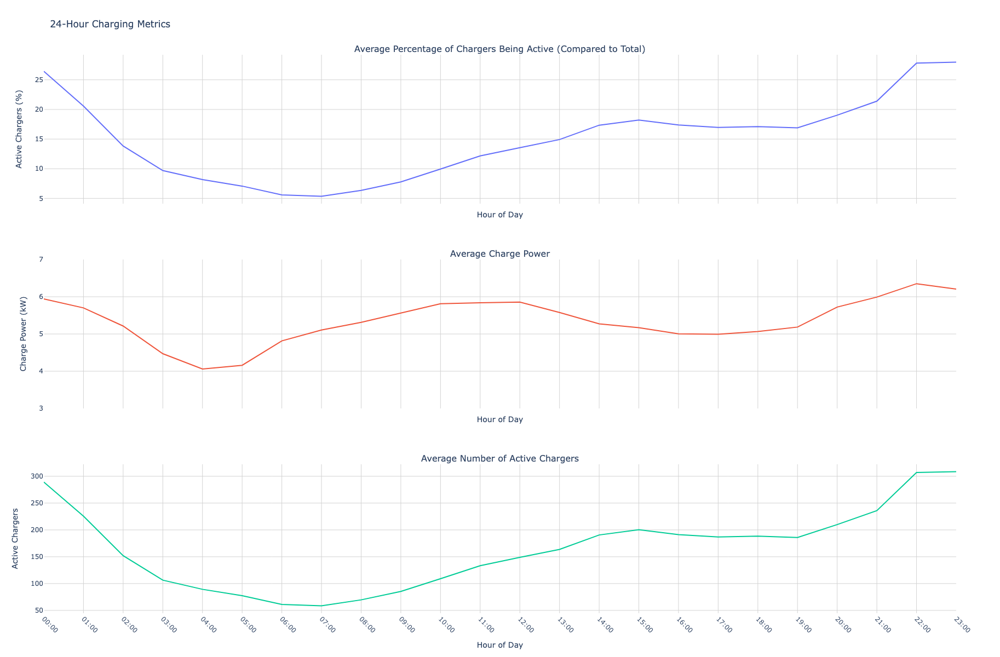

In [56]:
df['hour'] = pd.to_datetime(df['hour'])
df['hour_of_day'] = df['hour'].dt.hour


hourly_avg_total_power = df.groupby('hour_of_day')['active_chargers_pct_hourly'].mean().reset_index()
hourly_avg_charge_power = df.groupby('hour_of_day')['avg_charge_power_kw_hourly'].mean().reset_index()
hourly_avg_active_chargers = df.groupby('hour_of_day')['active_chargers_hourly'].mean().reset_index()

fig = make_subplots(rows=3, cols=1, shared_xaxes=True, vertical_spacing=0.1,
                    subplot_titles=('Average Percentage of Chargers Being Active (Compared to Total)',
                                    'Average Charge Power',
                                    'Average Number of Active Chargers'))

fig.add_trace(go.Scatter(x=hourly_avg_total_power['hour_of_day'], 
                         y=hourly_avg_total_power['active_chargers_pct_hourly'], 
                         mode='lines'), row=1, col=1)
fig.add_trace(go.Scatter(x=hourly_avg_charge_power['hour_of_day'], 
                         y=hourly_avg_charge_power['avg_charge_power_kw_hourly'], 
                         mode='lines'), row=2, col=1)
fig.add_trace(go.Scatter(x=hourly_avg_active_chargers['hour_of_day'], 
                         y=hourly_avg_active_chargers['active_chargers_hourly'], 
                         mode='lines'), row=3, col=1)

fig.update_layout(
    height=1200, 
    width=1200, 
    title_text="24-Hour Charging Metrics", 
    showlegend=False,
    plot_bgcolor='white',
    paper_bgcolor='white'
)

hour_labels = [f'{h:02d}:00' for h in range(24)]

for i in range(1, 4):
    fig.update_xaxes(title_text="Hour of Day", 
                     tickmode='array', 
                     tickvals=list(range(24)), 
                     ticktext=hour_labels,
                     tickangle=45,
                     row=i, col=1,
                     gridcolor='lightgrey')

fig.update_yaxes(title_text="Active Chargers (%)", row=1, col=1, gridcolor='lightgrey')
fig.update_yaxes(title_text="Charge Power (kW)", row=2, col=1, gridcolor='lightgrey')
fig.update_yaxes(title_text="Active Chargers", row=3, col=1, gridcolor='lightgrey')

fig.update_yaxes(range=[3, 7], row=2, col=1)

fig.show()

In [57]:
metrics = ['active_chargers_pct_hourly', 'avg_charge_power_kw_hourly', 'active_chargers_hourly', 'estimated_chargers_needed_for_100kw_hourly']
stats = ['mean', 'median', 'std', '95th_percentile', 'max', 'min']

stats_data = []

for metric in metrics:
    metric_stats = {
        'Metric': metric,
        'Mean': df[metric].mean(),
        'Median': df[metric].median(),
        'Standard Deviation': df[metric].std(),
        '95th Percentile': df[metric].quantile(0.80),
        'Maximum': df[metric].max(),
        'Minimum': df[metric].min()
    }
    stats_data.append(metric_stats)

stats_df = pd.DataFrame(stats_data)
stats_df

,Metric,Mean,Median,Standard Deviation,95th Percentile,Maximum,Minimum
0,active_chargers_pct_hourly,15.066838,15.085,7.652004,20.73,38.59,3.52
1,avg_charge_power_kw_hourly,5.349387,5.355,0.714464,5.95,6.87,3.15
2,active_chargers_hourly,165.607843,163.000,85.814113,225.00,472.00,38.00
3,estimated_chargers_needed_for_100kw_hourly,178.742647,125.500,123.416814,281.80,677.00,38.00


## Estimated Number of Chargers Needed to Reach 100 kW Hourly

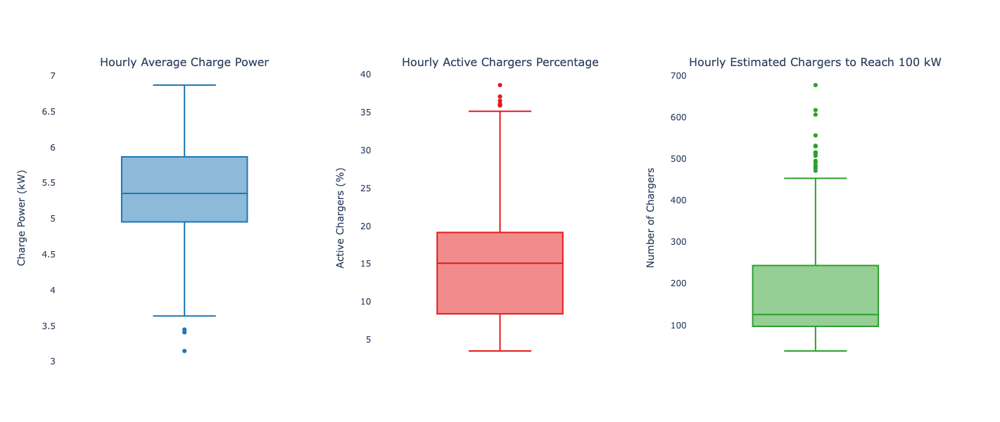

In [58]:
fig = make_subplots(rows=1, cols=3, 
                    subplot_titles=('Hourly Average Charge Power',
                                    'Hourly Active Chargers Percentage',
                                    'Hourly Estimated Chargers to Reach 100 kW'))

fig.add_trace(
    go.Box(y=df['avg_charge_power_kw_hourly'], name='Avg Charge Power', marker_color='#1f77b4'),
    row=1, col=1
)

fig.add_trace(
    go.Box(y=df['active_chargers_pct_hourly'], name='Active Chargers %', marker_color='#e41a1c'),
    row=1, col=2
)

fig.add_trace(
    go.Box(y=df['estimated_chargers_needed_for_100kw_hourly'], name='Estimated Chargers', marker_color='#2ca02c'),
    row=1, col=3
)

fig.update_layout(
    height=600,
    width=1200,
    showlegend=False,
    plot_bgcolor='white',
    paper_bgcolor='white'
)

fig.update_yaxes(title_text="Charge Power (kW)", row=1, col=1)
fig.update_yaxes(title_text="Active Chargers (%)", row=1, col=2)
fig.update_yaxes(title_text="Number of Chargers", row=1, col=3)
fig.update_xaxes(showticklabels=False)
fig.show()

In [59]:
print(f"Chargers needed to reach 100 kW hourly: {df['estimated_chargers_needed_for_100kw_hourly'].mean()} (mean), {df['estimated_chargers_needed_for_100kw_hourly'].median()} (median)")

Chargers needed to reach 100 kW hourly: 178.74264705882354 (mean), 125.5 (median)


In [45]:
columns_to_analyze = [
    'total_chargers_hourly',
    'active_chargers_hourly',
    'active_chargers_pct_hourly',
    'avg_charge_power_kw_hourly',
    'avg_charge_time_minutes_hourly',
    'avg_charge_time_pct_hourly',
    'estimated_chargers_needed_for_100kw_hourly',
    'theoretical_chargers_needed_for_100kw_hourly',
    'total_chargers_daily',
    'min_chargers_needed_daily',
    'max_chargers_needed_daily',
    'avg_chargers_needed_daily',
    'min_chargers_needed_2w',
    'max_chargers_needed_2w',
    'avg_chargers_needed_2w',
]

def get_stats(column):
    return pd.Series({
        'mean': column.mean(),
        'median': column.median(),
        'std': column.std(),
        'min': column.min(),
        'max': column.max(),
        '25%': column.quantile(0.25),
        '75%': column.quantile(0.75)
    })

stats = df[columns_to_analyze].apply(get_stats)
stats_transposed = stats.transpose()
stats_transposed

,mean,median,std,min,max,25%,75%
total_chargers_hourly,303.330882,319.000000,96.218684,118.000000,564.000000,215.000000,382.250000
active_chargers_hourly,172.921569,169.000000,84.916515,41.000000,475.000000,104.000000,222.000000
active_chargers_pct_hourly,11.287206,11.255000,5.572046,2.810000,30.410000,6.700000,14.285000
avg_charge_power_kw_hourly,5.365564,5.375000,0.708245,2.970000,6.820000,4.970000,5.890000
avg_charge_time_minutes_hourly,16.818382,15.310000,8.101132,3.240000,40.360000,12.227500,20.102500
avg_charge_time_pct_hourly,48.426995,47.660678,12.284131,17.815479,78.760919,42.299483,54.717967
estimated_chargers_needed_for_100kw_hourly,229.191176,169.000000,148.049390,49.000000,899.000000,129.000000,307.500000
theoretical_chargers_needed_for_100kw_hourly,19.497549,19.000000,2.838831,15.000000,34.000000,17.000000,21.000000
total_chargers_daily,1534.647059,1533.000000,86.932960,1380.000000,1775.000000,1483.000000,1567.000000
min_chargers_needed_daily,69.941176,68.000000,15.962378,49.000000,123.000000,61.000000,74.000000


# Charger Metrics on Charger Level

In [785]:
q = '''

WITH charging_events AS (
  SELECT
    ds.external_id,
    ds.event_publish_time,
    ds.charge_power,
    ds.type AS charger_type,  -- Add this line
    DATE(ds.event_publish_time) AS event_date,
    TIMESTAMP_DIFF(LEAD(ds.event_publish_time) OVER (PARTITION BY ds.external_id ORDER BY ds.event_publish_time), ds.event_publish_time, MILLISECOND) / 1000.0 AS duration_seconds
  FROM `fever-data-prod.fever.device_state` ds
  INNER JOIN `fever-data-prod.fever.assets` a ON ds.asset_id = a.id
  WHERE a.organization_id = '90d4188b-f6e6-4150-93d9-c3e23610d084'
    AND ds.event_publish_time >= '2024-05-15 00:00:00'
    AND ds.event_publish_time < '2024-06-01 00:00:00'
    AND a.id IN ('98b95ea6-16e8-45de-83b1-f5676d373e8d') -- SE3 bidding zone
),
session_starts AS (
  SELECT
    external_id,
    charger_type,  
    event_date,
    event_publish_time,
    charge_power,
    duration_seconds,
    CASE
      WHEN charge_power > 0 AND LAG(charge_power) OVER (PARTITION BY external_id ORDER BY event_publish_time) <= 0 THEN 1
      ELSE 0
    END AS is_session_start
  FROM charging_events
),
charging_sessions AS (
  SELECT
    external_id,
    charger_type,  -- Add this line
    event_date,
    event_publish_time,
    charge_power,
    duration_seconds,
    SUM(is_session_start) OVER (PARTITION BY external_id ORDER BY event_publish_time) AS session_id
  FROM session_starts
),
hourly_sessions AS (
  SELECT
    external_id,
    charger_type,  -- Add this line
    event_date,
    EXTRACT(HOUR FROM event_publish_time) AS hour,
    session_id,
    SUM(CASE WHEN charge_power > 0 THEN LEAST(duration_seconds, 3600) ELSE 0 END) AS hourly_charging_seconds
  FROM charging_sessions
  GROUP BY external_id, charger_type, event_date, hour, session_id  -- Add charger_type here
),
session_summaries AS (
  SELECT
    external_id,
    charger_type,
    event_date,
    session_id,
    SUM(CASE WHEN charge_power > 0 THEN duration_seconds ELSE 0 END) AS session_duration,
    MAX(charge_power) AS max_charge_power
  FROM charging_sessions
  GROUP BY external_id, charger_type, event_date, session_id
),
daily_sessions AS (
  SELECT
    ss.external_id,
    ss.charger_type,
    ss.event_date,
    COUNT(DISTINCT CASE WHEN ss.session_duration >= 10 THEN ss.session_id END) AS valid_sessions_daily,
    COUNT(DISTINCT CASE WHEN ss.session_duration < 10 THEN ss.session_id END) AS excluded_sessions_daily,
    MIN(CASE WHEN ss.session_duration >= 10 THEN ss.session_duration END) AS min_session_duration_daily,
    SUM(CASE WHEN ss.session_duration >= 10 THEN hs.hourly_charging_seconds ELSE 0 END) / 3600.0 AS total_charging_hours_daily
  FROM session_summaries ss
  LEFT JOIN hourly_sessions hs ON ss.external_id = hs.external_id AND ss.event_date = hs.event_date AND ss.session_id = hs.session_id AND ss.charger_type = hs.charger_type
  GROUP BY ss.external_id, ss.charger_type, ss.event_date
)
SELECT
  external_id,
  charger_type,
  event_date,
  valid_sessions_daily,
  excluded_sessions_daily,
  min_session_duration_daily,
  total_charging_hours_daily,
  (total_charging_hours_daily / NULLIF(valid_sessions_daily, 0)) AS avg_charging_time_per_session_hours_daily
FROM daily_sessions
ORDER BY external_id, charger_type, event_date
'''

df = bq_run(q)

In [786]:
df.to_csv('df_id_level_metrics.csv')

In [934]:
df = pd.read_csv('df_id_level_metrics.csv')

In [845]:
df.describe()

,Unnamed: 0,valid_sessions_daily,excluded_sessions_daily,min_session_duration_daily,total_charging_hours_daily,avg_charging_time_per_session_hours_daily
count,26119.000000,26119.000000,26119.000000,18697.000000,26119.000000,18697.000000
mean,13059.000000,2.384854,1.392396,3361.497292,2.034272,1.401591
std,7540.050177,4.464979,3.466241,5089.056063,2.149076,1.290976
min,0.000000,0.000000,0.000000,10.000000,0.000000,0.002786
25%,6529.500000,0.000000,1.000000,58.264000,0.000000,0.509215
50%,13059.000000,1.000000,1.000000,701.139000,1.664619,1.018699
75%,19588.500000,3.000000,1.000000,5088.956000,3.185554,1.942416
max,26118.000000,277.000000,285.000000,52534.906000,19.341233,14.585233



Average Total charging hours per car per day:
Overall: 2.03 (Total chargers: 2250)
easee: 1.95 (Chargers: 1067)
zaptec: 2.12 (Chargers: 1183)


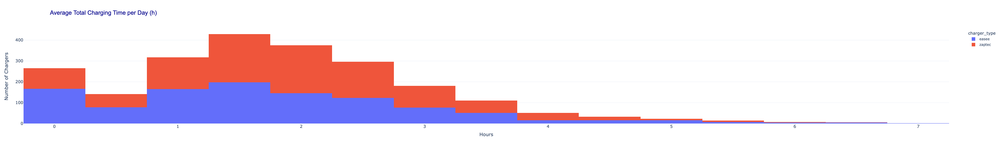

In [789]:
print("\nAverage Total charging hours per car per day:")
overall_avg = df['total_charging_hours_daily'].mean()
total_chargers = df['external_id'].nunique()
print(f"Overall: {round(overall_avg, 2)} (Total chargers: {total_chargers})")

for charger_type in df['charger_type'].unique():
    charger_df = df[df['charger_type'] == charger_type]
    avg_hours = charger_df['total_charging_hours_daily'].mean()
    charger_count = charger_df['external_id'].nunique()
    print(f"{charger_type}: {round(avg_hours, 2)} (Chargers: {charger_count})")
    
histogram('Average Total Charging Time per Day (h)', 'Hours', 'Number of Chargers', 'total_charging_hours_daily', type=True, limit=10)


Average charging time per session (hours):
Overall: 1.4 (Total chargers: 2250)
easee: 1.17 (Chargers: 1067)
zaptec: 1.6 (Chargers: 1183)


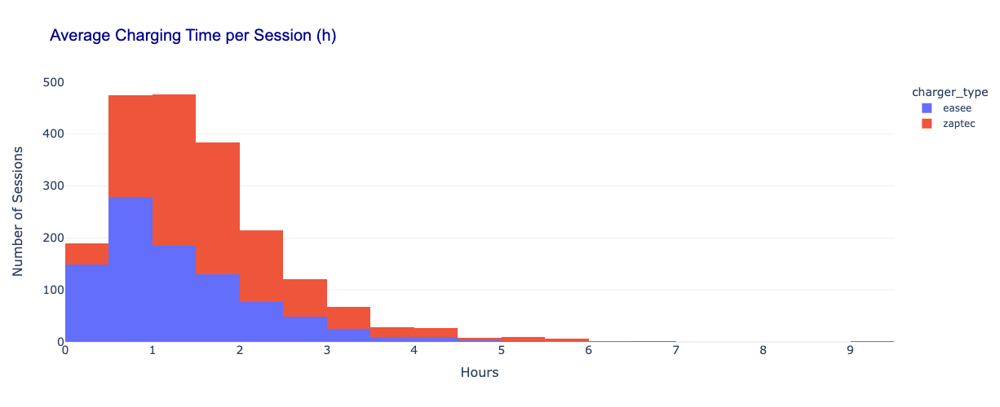

In [790]:
print("\nAverage charging time per session (hours):")
overall_avg = df['avg_charging_time_per_session_hours_daily'].mean()
total_chargers = df['external_id'].nunique()
print(f"Overall: {round(overall_avg, 2)} (Total chargers: {total_chargers})")

for charger_type in df['charger_type'].unique():
    charger_df = df[df['charger_type'] == charger_type]
    avg_time = charger_df['avg_charging_time_per_session_hours_daily'].mean()
    charger_count = charger_df['external_id'].nunique()
    print(f"{charger_type}: {round(avg_time, 2)} (Chargers: {charger_count})")
histogram('Average Charging Time per Session (h)', 'Hours', 'Number of Sessions', 'avg_charging_time_per_session_hours_daily', type=True, limit=10)


Average number of valid charging sessions per day:
Overall: 2.38 (Total chargers: 2250)
easee: 2.92 (Chargers: 1067)
zaptec: 1.85 (Chargers: 1183)


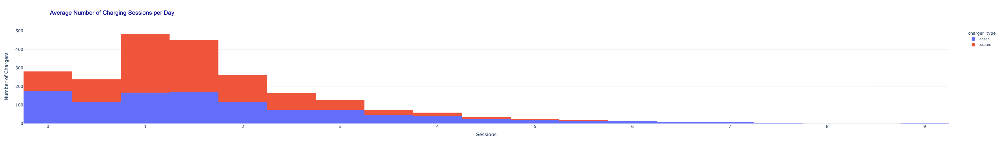

In [791]:
print(f"\nAverage number of valid charging sessions per day:")
print(f"Overall: {round(df['valid_sessions_daily'].mean(), 2)} (Total chargers: {df['external_id'].nunique()})")

for charger_type in df['charger_type'].unique():
    charger_df = df[df['charger_type'] == charger_type]
    avg_valid = charger_df['valid_sessions_daily'].mean()
    charger_count = charger_df['external_id'].nunique()
    print(f"{charger_type}: {round(avg_valid, 2)} (Chargers: {charger_count})")
histogram('Average Number of Charging Sessions per Day', 'Sessions', 'Number of Chargers', 'valid_sessions_daily', type=True, limit=10)


Average number of excluded charging sessions per day:
Overall: 1.39
easee: 1.8
zaptec: 0.99


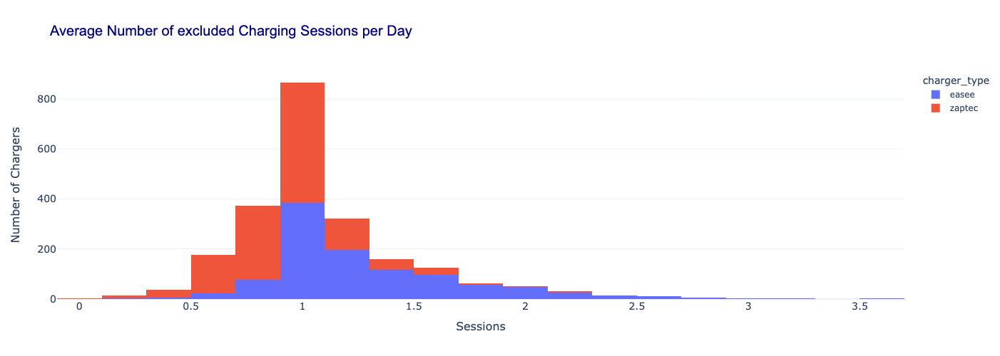

In [792]:
print(f"\nAverage number of excluded charging sessions per day:")
print(f"Overall: {round(df['excluded_sessions_daily'].mean(), 2)}")

for charger_type in df['charger_type'].unique():
    avg_excluded = df[df['charger_type'] == charger_type]['excluded_sessions_daily'].mean()
    print(f"{charger_type}: {round(avg_excluded, 2)}")
histogram('Average Number of excluded Charging Sessions per Day', 'Sessions', 'Number of Chargers', 'excluded_sessions_daily', type=True, limit=4)

## Charging Frequency Distribution

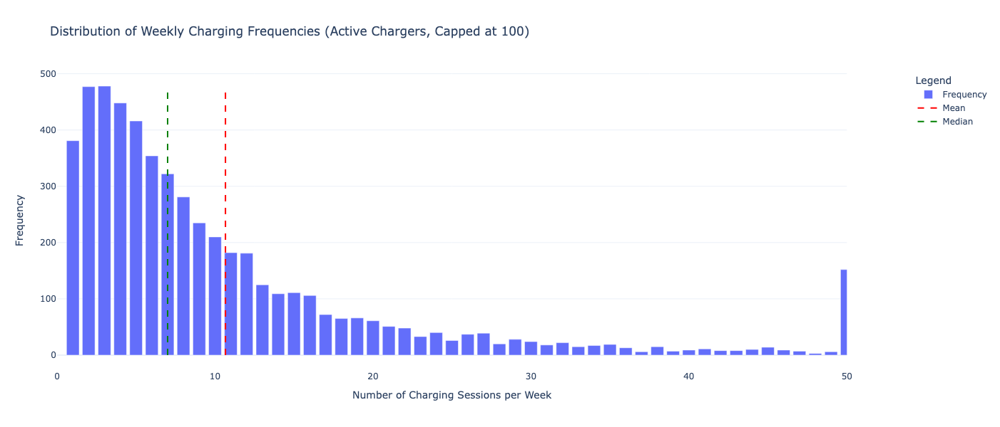

Average number of charging sessions per week (active chargers): 10.66
Median number of charging sessions per week (active chargers): 7.00

Distribution of weekly charging frequencies (active chargers, capped at 50):

Percentage of active charger-weeks: 86.32%


In [822]:
df['event_date'] = pd.to_datetime(df['event_date'])
df['week'] = df['event_date'].dt.isocalendar().week

weekly_charges = df.groupby(['external_id', 'charger_type', 'week'])['valid_sessions_daily'].sum().reset_index()
weekly_charges = weekly_charges[weekly_charges['valid_sessions_daily'] > 0]
weekly_charges['valid_sessions_daily'] = weekly_charges['valid_sessions_daily'].clip(upper=50)
charge_freq_dist = weekly_charges['valid_sessions_daily'].value_counts().sort_index()
avg_weekly_charges = weekly_charges['valid_sessions_daily'].mean()
median_weekly_charges = weekly_charges['valid_sessions_daily'].median()

fig = make_subplots(specs=[[{"secondary_y": True}]])

fig.add_trace(
    go.Bar(x=charge_freq_dist.index, y=charge_freq_dist.values, name="Frequency"),
    secondary_y=False,
)

fig.add_trace(
    go.Scatter(x=[avg_weekly_charges, avg_weekly_charges], y=[0, charge_freq_dist.max()], 
               mode="lines", name="Mean", line=dict(color="red", dash="dash")),
    secondary_y=False,
)

fig.add_trace(
    go.Scatter(x=[median_weekly_charges, median_weekly_charges], y=[0, charge_freq_dist.max()], 
               mode="lines", name="Median", line=dict(color="green", dash="dash")),
    secondary_y=False,
)

fig.update_layout(
    title="Distribution of Weekly Charging Frequencies (Active Chargers, Capped at 100)",
    xaxis_title="Number of Charging Sessions per Week",
    yaxis_title="Frequency",
    legend_title="Legend",
    hovermode="x unified",
    xaxis=dict(range=[0, 50]),
    height=600,
    width=1200
)


fig.update_xaxes(tick0=0, dtick=10) 


fig.show()


print(f"Average number of charging sessions per week (active chargers): {avg_weekly_charges:.2f}")
print(f"Median number of charging sessions per week (active chargers): {median_weekly_charges:.2f}")
total_charger_weeks = len(df.groupby(['external_id', 'charger_type', 'week']))
active_charger_weeks = len(weekly_charges)
active_percentage = (active_charger_weeks / total_charger_weeks) * 100
print(f"\nPercentage of active charger-weeks: {active_percentage:.2f}%")

## Inactive Chargers

In [1094]:
df_by_type = df.groupby(['external_id', 'charger_type'])['valid_sessions_daily'].sum().reset_index()
df_inactive_by_type = df_by_type[df_by_type['valid_sessions_daily'] == 0]
total_by_type = df_by_type['charger_type'].value_counts().sort_index()
inactive_by_type = df_inactive_by_type['charger_type'].value_counts().sort_index()

percentage_inactive = (inactive_by_type / total_by_type * 100).round(1)

for type_ in total_by_type.index:
    print(f"Type: {type_}")
    print(f"  Total chargers: {total_by_type[type_]}")
    print(f"  Inactive chargers: {inactive_by_type.get(type_, 0)}")
    print(f"  Percentage inactive: {percentage_inactive.get(type_, 0)}%")
    print()

print(f"Total number of inactive chargers: {inactive_by_type.sum()}")
print(f"Overall percentage of inactive chargers: {round(inactive_by_type.sum() / total_by_type.sum() * 100, 1)}%")

Type: easee
  Total chargers: 1067
  Inactive chargers: 152
  Percentage inactive: 14.2%

Type: zaptec
  Total chargers: 1183
  Inactive chargers: 89
  Percentage inactive: 7.5%

Total number of inactive chargers: 241
Overall percentage of inactive chargers: 10.7%


## Average Time Between Charging

In [870]:
q = '''

WITH charging_events AS (
  SELECT
    ds.external_id,
    ds.event_publish_time,
    ds.charge_power,
    ds.type AS charger_type,  -- Add this line
    DATE(ds.event_publish_time) AS event_date,
    TIMESTAMP_DIFF(LEAD(ds.event_publish_time) OVER (PARTITION BY ds.external_id ORDER BY ds.event_publish_time), ds.event_publish_time, MILLISECOND) / 1000.0 AS duration_seconds
  FROM `fever-data-prod.fever.device_state` ds
  INNER JOIN `fever-data-prod.fever.assets` a ON ds.asset_id = a.id
  WHERE a.organization_id = '90d4188b-f6e6-4150-93d9-c3e23610d084'
    AND ds.event_publish_time >= '2024-05-15 00:00:00'
    AND ds.event_publish_time < '2024-06-01 00:00:00'
    AND a.id IN ('98b95ea6-16e8-45de-83b1-f5676d373e8d') -- SE3 bidding zone
),
session_starts AS (
  SELECT
    external_id,
    charger_type,  -- Add this line
    event_date,
    event_publish_time,
    charge_power,
    duration_seconds,
    CASE
      WHEN charge_power > 0 AND LAG(charge_power) OVER (PARTITION BY external_id ORDER BY event_publish_time) <= 0 THEN 1
      ELSE 0
    END AS is_session_start
  FROM charging_events
),
charging_sessions AS (
  SELECT
    external_id,
    charger_type,  -- Add this line
    event_date,
    event_publish_time,
    charge_power,
    duration_seconds,
    SUM(is_session_start) OVER (PARTITION BY external_id ORDER BY event_publish_time) AS session_id
  FROM session_starts
),
session_times AS (
  SELECT
    external_id,
    charger_type,
    event_date,
    session_id,
    MIN(event_publish_time) AS session_start_time,
    MAX(event_publish_time) AS session_end_time,
    TIMESTAMP_DIFF(MAX(event_publish_time), MIN(event_publish_time), SECOND) AS session_duration_seconds
  FROM charging_sessions
  WHERE charge_power > 0
  GROUP BY external_id, charger_type, event_date, session_id
),
time_between_sessions AS (
  SELECT
    external_id,
    charger_type,
    session_start_time,
    session_duration_seconds,
    TIMESTAMP_DIFF(session_start_time, 
                   LAG(session_end_time) OVER (PARTITION BY external_id, charger_type ORDER BY session_start_time),
                   HOUR) AS hours_since_last_session
  FROM session_times
)
SELECT
  external_id,
  charger_type,
  AVG(CASE WHEN session_duration_seconds >= 10 THEN hours_since_last_session END) AS avg_hours_between_sessions_10s,
  AVG(CASE WHEN session_duration_seconds >= 300 THEN hours_since_last_session END) AS avg_hours_between_sessions_5min,
  AVG(CASE WHEN session_duration_seconds >= 1800 THEN hours_since_last_session END) AS avg_hours_between_sessions_30min
FROM time_between_sessions
WHERE hours_since_last_session IS NOT NULL
  AND hours_since_last_session <= 24*7  -- Filter out gaps longer than 7 days
GROUP BY external_id, charger_type
'''

df = bq_run(q)

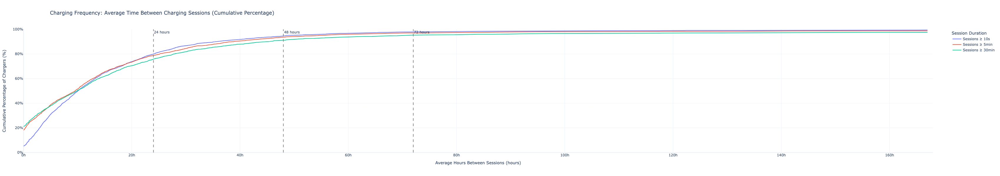


Sessions ≥ 10s:
  % of chargers with avg time between sessions ≤ 24 hours: 80.04%
  % of chargers with avg time between sessions ≤ 48 hours: 94.62%
  % of chargers with avg time between sessions ≤ 72 hours: 97.87%

Sessions ≥ 5min:
  % of chargers with avg time between sessions ≤ 24 hours: 78.82%
  % of chargers with avg time between sessions ≤ 48 hours: 93.65%
  % of chargers with avg time between sessions ≤ 72 hours: 97.05%

Sessions ≥ 30min:
  % of chargers with avg time between sessions ≤ 24 hours: 75.93%
  % of chargers with avg time between sessions ≤ 48 hours: 91.11%
  % of chargers with avg time between sessions ≤ 72 hours: 95.28%


In [882]:
def cumulative_percentage(series):
    return np.cumsum(series.value_counts().sort_index()) / len(series) * 100

cum_perc_10s = cumulative_percentage(df['avg_hours_between_sessions_10s'])
cum_perc_5min = cumulative_percentage(df['avg_hours_between_sessions_5min'])
cum_perc_30min = cumulative_percentage(df['avg_hours_between_sessions_30min'])

fig = go.Figure()

fig.add_trace(go.Scatter(x=cum_perc_10s.index, y=cum_perc_10s.values, 
                         mode='lines', name='Sessions ≥ 10s',
                         hovertemplate='Hours: %{x:.1f}<br>Cumulative %: %{y:.1f}%<extra></extra>'))

fig.add_trace(go.Scatter(x=cum_perc_5min.index, y=cum_perc_5min.values, 
                         mode='lines', name='Sessions ≥ 5min',
                         hovertemplate='Hours: %{x:.1f}<br>Cumulative %: %{y:.1f}%<extra></extra>'))

fig.add_trace(go.Scatter(x=cum_perc_30min.index, y=cum_perc_30min.values, 
                         mode='lines', name='Sessions ≥ 30min',
                         hovertemplate='Hours: %{x:.1f}<br>Cumulative %: %{y:.1f}%<extra></extra>'))

# Update layout
fig.update_layout(
    title="Charging Frequency: Average Time Between Charging Sessions (Cumulative Percentage)",
    xaxis_title="Average Hours Between Sessions (hours)",
    yaxis_title="Cumulative Percentage of Chargers (%)",
    legend_title="Session Duration",
    hovermode="x unified",
    xaxis=dict(
        range=[0, 168],  # Set x-axis range from 0 to 168 hours (7 days)
        ticksuffix="h"  # Add 'hours' suffix to x-axis tick labels
    ),
    yaxis=dict(
        range=[0, 100], 
        tickformat='.0f',
        ticksuffix="%"  # Add percentage symbol to y-axis tick labels
    ),
    height=600,
    width=1200
)

for hours in [24, 48, 72]:
    fig.add_vline(x=hours, line_dash="dash", line_color="gray", annotation_text=f"{hours} hours")

fig.show()

for duration, series in [('10s', cum_perc_10s), ('5min', cum_perc_5min), ('30min', cum_perc_30min)]:
    print(f"\nSessions ≥ {duration}:")
    for hours in [24, 48, 72]:
        percentage = series[series.index <= hours].iloc[-1] if not series[series.index <= hours].empty else 0
        print(f"  % of chargers with avg time between sessions ≤ {hours} hours: {percentage:.2f}%")

## Charging Instability

In [19]:
q = '''
WITH charging_events AS (
  SELECT
    ds.external_id,
    ds.event_publish_time,
    ds.charge_power,
    ds.type AS charger_type,
    DATE(ds.event_publish_time) AS event_date,
    TIMESTAMP_DIFF(LEAD(ds.event_publish_time) OVER (PARTITION BY ds.external_id ORDER BY ds.event_publish_time), ds.event_publish_time, MILLISECOND) / 1000.0 AS duration_seconds
  FROM `fever-data-prod.fever.device_state` ds
  INNER JOIN `fever-data-prod.fever.assets` a ON ds.asset_id = a.id
  WHERE a.organization_id = '90d4188b-f6e6-4150-93d9-c3e23610d084'
    AND ds.event_publish_time >= '2024-05-15 00:00:00'
    AND ds.event_publish_time < '2024-06-01 00:00:00'
    AND a.id IN ('98b95ea6-16e8-45de-83b1-f5676d373e8d')
),
session_starts AS (
  SELECT
    external_id,
    charger_type,
    event_date,
    event_publish_time,
    charge_power,
    duration_seconds,
    CASE
      WHEN charge_power > 0 AND LAG(charge_power) OVER (PARTITION BY external_id ORDER BY event_publish_time) <= 0 THEN 1
      ELSE 0
    END AS is_session_start
  FROM charging_events
),
charging_sessions AS (
  SELECT
    external_id,
    charger_type,
    event_date,
    event_publish_time,
    charge_power,
    duration_seconds,
    is_session_start,
    SUM(is_session_start) OVER (PARTITION BY external_id ORDER BY event_publish_time) AS session_id
  FROM session_starts
),
hourly_sessions AS (
  SELECT
    external_id,
    charger_type,
    event_date,
    EXTRACT(HOUR FROM event_publish_time) AS hour,
    session_id,
    SUM(CASE WHEN charge_power > 0 THEN LEAST(duration_seconds, 3600) ELSE 0 END) AS hourly_charging_seconds
  FROM charging_sessions
  GROUP BY external_id, charger_type, event_date, hour, session_id
),
session_summaries AS (
  SELECT
    external_id,
    charger_type,
    event_date,
    session_id,
    SUM(CASE WHEN charge_power > 0 THEN duration_seconds ELSE 0 END) AS session_duration,
    AVG(CASE WHEN charge_power > 0 THEN charge_power END) AS avg_charge_power,
    MAX(charge_power) AS max_charge_power,
    STDDEV(CASE WHEN charge_power > 0 THEN charge_power END) AS power_std,
    SUM(is_session_start) AS start_stop_count
  FROM charging_sessions
  GROUP BY external_id, charger_type, event_date, session_id
),
session_max_power AS (
  SELECT
    external_id,
    session_id,
    MAX(charge_power) AS max_charge_power
  FROM charging_sessions
  GROUP BY external_id, session_id
),
session_metrics AS (
  SELECT
    ss.*,
    SUM(CASE WHEN cs.charge_power > 0.9 * smp.max_charge_power THEN cs.duration_seconds ELSE 0 END) AS high_power_duration
  FROM session_summaries ss
  JOIN session_max_power smp ON ss.external_id = smp.external_id AND ss.session_id = smp.session_id
  JOIN charging_sessions cs ON ss.external_id = cs.external_id AND ss.session_id = cs.session_id
  GROUP BY ss.external_id, ss.charger_type, ss.event_date, ss.session_id, ss.session_duration, ss.avg_charge_power, ss.max_charge_power, ss.power_std, ss.start_stop_count
)
SELECT
  external_id,
  charger_type,
  COUNT(*) AS session_count,
  AVG(session_duration / 3600.0) AS avg_session_duration_hours,
  AVG(avg_charge_power) AS avg_charge_power,
  AVG(max_charge_power) AS avg_max_charge_power,
  SUM(start_stop_count) AS total_start_stop_count,
  SUM(start_stop_count) / (SUM(session_duration) / 3600.0) AS instability_score,
  AVG(power_std / NULLIF(avg_charge_power, 0)) AS avg_power_variation_coefficient,
  AVG(high_power_duration / NULLIF(session_duration, 0)) AS avg_pct_time_at_high_power,
  AVG((max_charge_power - avg_charge_power) / NULLIF(max_charge_power, 0)) AS avg_power_drop_pct
FROM session_metrics
WHERE session_duration > 0
GROUP BY external_id, charger_type
ORDER BY avg_session_duration_hours DESC

'''

df_instability = bq_run(q)

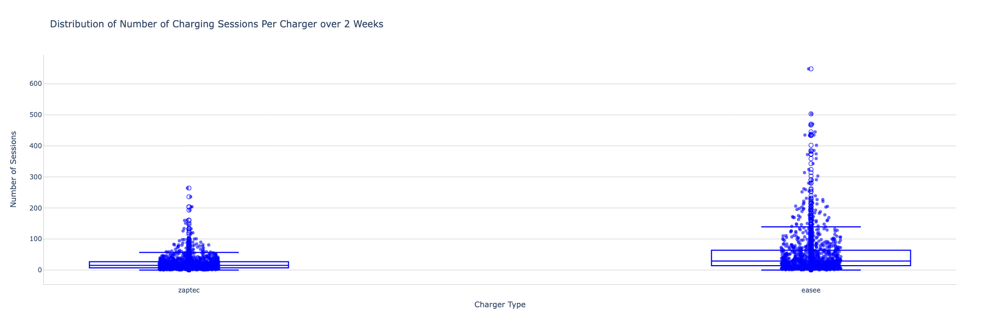

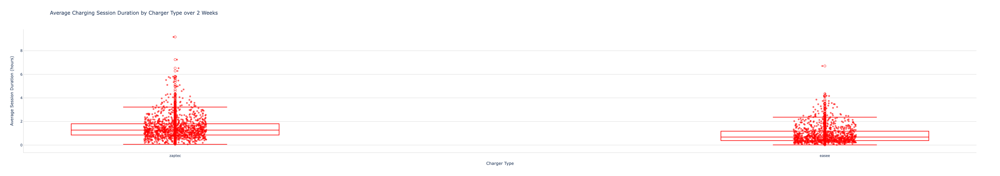

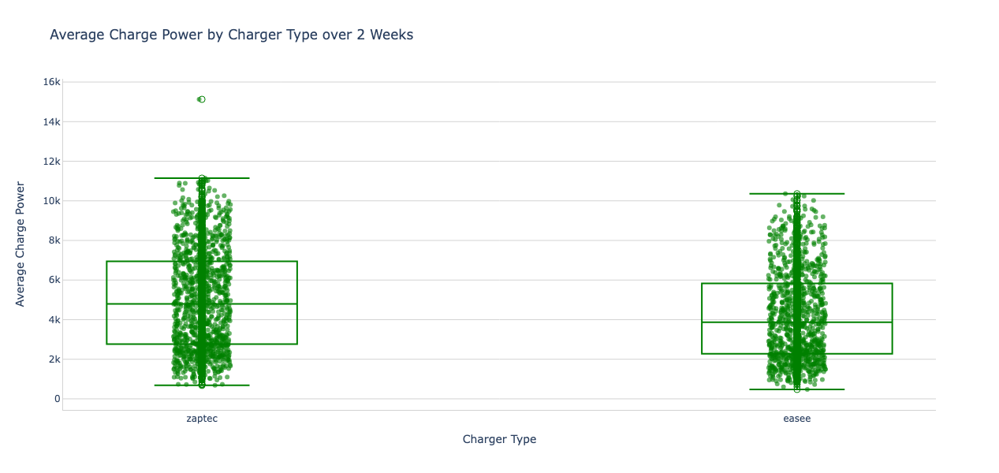

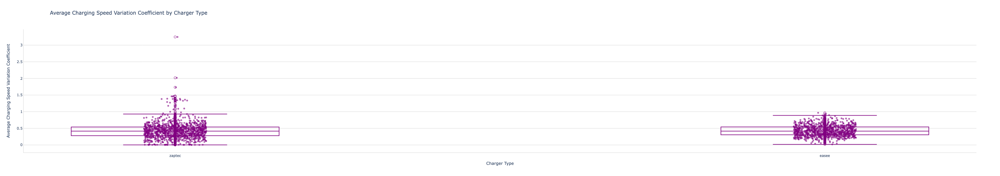

In [23]:
import pandas as pd
import numpy as np
import plotly.graph_objects as go

# Function to calculate percentile
def get_percentile(series, value):
    return (series <= value).mean() * 100


def add_box_plot(fig, x_pos, data, charger_type, color):
    fig.add_trace(go.Box(
        x=[x_pos] * len(data),
        y=data,
        name=charger_type,
        boxpoints='all',
        jitter=0.3,
        pointpos=0,
        marker=dict(color=color, opacity=0.6),
        line=dict(color=color),
        fillcolor='rgba(255,255,255,0)',
        showlegend=False,
        width=box_width
    ))
    
    fig.add_trace(go.Scatter(
        x=[x_pos] * len(data),
        y=data,
        mode='markers',
        marker=dict(color=color, symbol='circle-open', size=8, opacity=1),
        showlegend=False,
        hoverinfo='y'
    ))

def calculate_metrics(data, charger_type):
    return {
        'charger_type': charger_type,
        'mean': np.mean(data),
        'median': np.median(data),
        'q1': np.percentile(data, 25),
        'q3': np.percentile(data, 75),
        'min': np.min(data),
        'max': np.max(data)
    }

def update_layout(fig, title, y_axis_title):
    fig.update_layout(
        title=title,
        xaxis=dict(
            ticktext=charger_types,
            tickvals=[i + i * charger_gap for i in range(len(charger_types))],
            title='Charger Type',
            showgrid=False
        ),
        yaxis=dict(
            title=y_axis_title,
            zeroline=True,
            zerolinewidth=1,
            zerolinecolor='lightgrey',
            gridcolor='lightgrey'
        ),
        plot_bgcolor='white',
        width=1000,
        height=600,
        boxmode='group'
    )
    fig.update_xaxes(showline=True, linewidth=1, linecolor='lightgrey')
    fig.update_yaxes(showline=True, linewidth=1, linecolor='lightgrey')

# Colors for different metrics
colors = {'start_stop': 'blue', 'duration': 'red', 'charge_power': 'green', 'power_cv': 'purple'}

# Plot parameters
box_width = 0.4
group_gap = 0.1
charger_gap = 0.25

# Get unique charger types
charger_types = df_instability['charger_type'].unique()

# Create figures
fig1 = go.Figure()  # for start/stop count
fig2 = go.Figure()  # for average session duration
fig3 = go.Figure()  # for average charge power
fig4 = go.Figure()  # for average power coefficient of variation

# Lists to store metrics
metrics_list_start_stop = []
metrics_list_duration = []
metrics_list_charge_power = []
metrics_list_power_cv = []

for i, charger_type in enumerate(charger_types):
    df_subset = df_instability[df_instability['charger_type'] == charger_type]
    
    x_pos = i + i * charger_gap

    # Start/Stop Count
    start_stop_counts = df_subset['total_start_stop_count'].dropna()
    add_box_plot(fig1, x_pos, start_stop_counts, charger_type, colors['start_stop'])
    metrics_list_start_stop.append(calculate_metrics(start_stop_counts, charger_type))

    # Average Session Duration
    durations = df_subset['avg_session_duration_hours'].dropna()
    add_box_plot(fig2, x_pos, durations, charger_type, colors['duration'])
    metrics_list_duration.append(calculate_metrics(durations, charger_type))

    # Average Charge Power
    charge_powers = df_subset['avg_charge_power'].dropna()
    add_box_plot(fig3, x_pos, charge_powers, charger_type, colors['charge_power'])
    metrics_list_charge_power.append(calculate_metrics(charge_powers, charger_type))

    # Average Power Coefficient of Variation
    power_cvs = df_subset['avg_power_variation_coefficient'].dropna()
    add_box_plot(fig4, x_pos, power_cvs, charger_type, colors['power_cv'])
    metrics_list_power_cv.append(calculate_metrics(power_cvs, charger_type))

# Update layouts
update_layout(fig1, 'Distribution of Number of Charging Sessions Per Charger over 2 Weeks', 'Number of Sessions')
update_layout(fig2, 'Average Charging Session Duration by Charger Type over 2 Weeks', 'Average Session Duration (hours)')
update_layout(fig3, 'Average Charge Power by Charger Type over 2 Weeks', 'Average Charge Power')
update_layout(fig4, 'Average Charging Speed Variation Coefficient by Charger Type', 'Average Charging Speed Variation Coefficient')

# Show plots
fig1.show()
fig2.show()
fig3.show()
fig4.show()


In [61]:
metrics_df_start_stop = pd.DataFrame(metrics_list_start_stop)
print("\nNumber of charging session metrics:\n")
metrics_df_start_stop


Number of charging session metrics:



,charger_type,mean,median,q1,q3,min,max
0,zaptec,21.803473,15.0,7.0,27.0,0,264
1,easee,54.189071,29.0,14.0,64.0,0,648


In [62]:
metrics_df_duration = pd.DataFrame(metrics_list_duration)
print("\nSession duration metrics:\n")
metrics_df_duration


Session duration metrics:



,charger_type,mean,median,q1,q3,min,max
0,zaptec,1.477671,1.269441,0.852256,1.802648,0.066064,9.169677
1,easee,0.905220,0.676555,0.380094,1.174406,0.013629,6.706909


## Charger Reaction Speed

In [7]:
q = '''

SELECT
  type,
  command_time,
  reaction_time_seconds,
  command,
  status
FROM
  `fever-data-prod.greenely.commands_reaction_speed`
WHERE
  command_time >= '2024-03-01 00:00:00'
  AND command_time < '2024-07-01 00:00:00'
  AND asset_id = '98b95ea6-16e8-45de-83b1-f5676d373e8d'

'''

df_speed = bq_run(q)

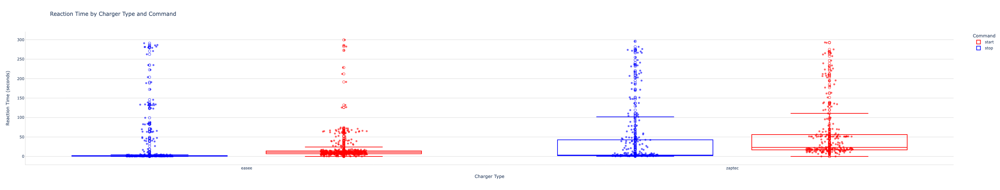

,charger_type,command,mean,median,q1,q3,iqr,min,max,percentile_7_5s,p90
0,easee,stop,17.596660,1.13,0.6400,2.1150,1.4750,0.01,291.02,86.509636,48.378
1,easee,start,19.086208,10.73,6.9425,14.1350,7.1925,0.01,299.56,27.966102,41.219
2,zaptec,stop,43.546541,3.51,2.0050,42.7125,40.7075,0.26,295.90,61.278195,187.345
3,zaptec,start,59.170129,23.29,16.8400,56.1000,39.2600,0.04,292.96,2.145923,192.366


In [22]:
fig = go.Figure()
colors = {'stop': 'blue', 'start': 'red'}
charger_types = ['easee', 'zaptec']

box_width = 0.4
group_gap = 0.1
charger_gap = 0.25

metrics_list = []

def get_percentile(series, value):
    return (series <= value).mean() * 100

for i, charger_type in enumerate(charger_types):
    for j, command in enumerate(['stop', 'start']):
        df_subset = df_speed[(df_speed['type'] == charger_type) & (df_speed['command'] == command)]
        df_subset['reaction_time_seconds'] = pd.to_numeric(df_subset['reaction_time_seconds'], errors='coerce')
        
        x_pos = i + (j - 0.5) * (box_width + group_gap) + i * charger_gap
        
        reaction_times = df_subset['reaction_time_seconds'].dropna()
        avg_reaction_time = np.mean(reaction_times)
        median_reaction_time = np.median(reaction_times)
        q1 = np.percentile(reaction_times, 25)
        q3 = np.percentile(reaction_times, 75)
        iqr = q3 - q1
        min_val = np.min(reaction_times)
        max_val = np.max(reaction_times)
        
        percentile_7_5s = get_percentile(reaction_times, 7.5)
        p90 = np.percentile(reaction_times, 90)
        
        # Store metrics in the list
        metrics_list.append({
            'charger_type': charger_type,
            'command': command,
            'mean': avg_reaction_time,
            'median': median_reaction_time,
            'q1': q1,
            'q3': q3,
            'iqr': iqr,
            'min': min_val,
            'max': max_val,
            'percentile_7_5s': percentile_7_5s,
            'p90': p90,
            #'n': len(df_subset)
        })
        

        fig.add_trace(go.Box(
            x=[x_pos] * len(reaction_times),
            y=reaction_times,
            name=command,
            boxpoints='all',
            jitter=0.3,
            pointpos=0,
            marker=dict(color=colors[command], opacity=0.6),
            line=dict(color=colors[command]),
            fillcolor='rgba(255,255,255,0)',
            legendgroup=command,
            showlegend=i == 0,
            width=box_width
        ))
        

        fig.add_trace(go.Scatter(
            x=[x_pos] * len(reaction_times),
            y=reaction_times,
            mode='markers',
            marker=dict(color=colors[command], symbol='circle-open', size=8, opacity=1),
            legendgroup=command,
            showlegend=False,
            hoverinfo='y'
        ))


metrics_df = pd.DataFrame(metrics_list)

fig.update_layout(
    title='Reaction Time by Charger Type and Command',
    xaxis=dict(
        ticktext=charger_types,
        tickvals=[i + i * charger_gap for i in range(len(charger_types))],
        title='Charger Type',
        showgrid=False
    ),
    yaxis=dict(
        title='Reaction Time (seconds)',
        zeroline=True,
        zerolinewidth=1,
        zerolinecolor='lightgrey',
        gridcolor='lightgrey'
    ),
    legend=dict(
        title='Command',
        traceorder='reversed'
    ),
    plot_bgcolor='white',
    width=1000,
    height=600,
    boxmode='group'
)

fig.update_xaxes(showline=True, linewidth=1, linecolor='lightgrey')
fig.update_yaxes(showline=True, linewidth=1, linecolor='lightgrey')

fig.show()

metrics_df

### Non-responding Chargers

In [9]:
q = '''

WITH device_states AS (
  SELECT
    event_message_id,
    event_publish_time,
    asset_id,
    ds.external_id,
    charge_power,
    LAG(charge_power) OVER (PARTITION BY ds.external_id ORDER BY event_publish_time) AS prev_charge_power,
    TIMESTAMP_DIFF(LEAD(ds.event_publish_time) OVER (PARTITION BY ds.external_id ORDER BY ds.event_publish_time), ds.event_publish_time, MILLISECOND) / 1000.0 AS duration_seconds,
    ds.type
  FROM
    `fever-data-prod.fever.device_state` ds
  INNER JOIN
    `fever-data-prod.fever.assets` a
  ON
    ds.asset_id = a.id
  WHERE
    -- Greenely organization id
    ds.event_publish_time >= '2024-03-01 00:00:00'
    AND ds.event_publish_time < '2024-08-01 00:00:00'
    AND a.id IN ('98b95ea6-16e8-45de-83b1-f5676d373e8d') -- SE3 bidding zone
),
commands AS (
  SELECT
    event_publish_time AS command_time,
    external_id,
    control_id,
    command,
    reason
  FROM
    `fever-data-prod.fever.device_control_log`
),
states_with_reaction AS (
  SELECT
    ds.event_publish_time,
    ds.external_id,
    ds.asset_id,
    ds.type,
    ROUND(ds.charge_power, 2) AS charge_power,
    cmd.control_id,
    cmd.command,
    cmd.reason,
    cmd.command_time,
    ROUND(TIMESTAMP_DIFF(ds.event_publish_time, cmd.command_time, MILLISECOND) / 1000.0, 2) AS reaction_time_seconds,
    CASE
      WHEN (cmd.command = 'start' AND ds.charge_power > 0 AND ds.prev_charge_power = 0) THEN 'did_start'
      WHEN (cmd.command = 'start' AND ds.charge_power > 0 AND ds.prev_charge_power > 0) THEN 'already_started'
      WHEN (cmd.command = 'stop' AND ds.charge_power = 0 AND ds.prev_charge_power > 0) THEN 'did_stop'
      WHEN (cmd.command = 'stop' AND ds.charge_power = 0 AND ds.prev_charge_power = 0) THEN 'already_stopped'
      ELSE 'other'
    END AS response
  FROM
    device_states ds
  INNER JOIN
    commands cmd
  ON
    ds.external_id = cmd.external_id
  WHERE
    ds.event_publish_time > cmd.command_time
    -- 5 min threshold for state updates after a command. If no state update, the status is set to did_not_respond.
    AND TIMESTAMP_DIFF(ds.event_publish_time, cmd.command_time, SECOND) < 60*5 
),
classified_states AS (
  SELECT
    *,
    CASE
      WHEN response IN ('did_start', 'did_stop') AND reaction_time_seconds < 5 THEN 'did_respond'
      WHEN response IN ('did_start', 'did_stop') THEN 'did_respond_with_delay'
      ELSE 'did_not_respond'
    END AS status
  FROM
    states_with_reaction
  WHERE
    response NOT IN ('already_started', 'already_stopped')
),
ranked_states AS (
  SELECT
    *,
    ROW_NUMBER() OVER (PARTITION BY external_id, command, command_time ORDER BY 
      CASE status
        WHEN 'did_respond' THEN 1
        WHEN 'did_respond_with_delay' THEN 2
        ELSE 3
      END, 
      event_publish_time) AS response_rank
  FROM
    classified_states
  QUALIFY response_rank = 1
)

SELECT
  event_publish_time,
  command_time,
  external_id,
  type,
  command,
  reason,
  status,
  IF(status = 'did_not_respond', NULL, reaction_time_seconds) AS reaction_time_seconds,
FROM
  ranked_states

'''

df_commands = bq_run(q)

In [25]:
df_commands[df_commands['type'] == 'easee'].reason.value_counts()

reason
stop                         716
reset                        234
start                        157
removeMisbehavingChargers    123
guardFromOverCommitting       16
Name: count, dtype: int64

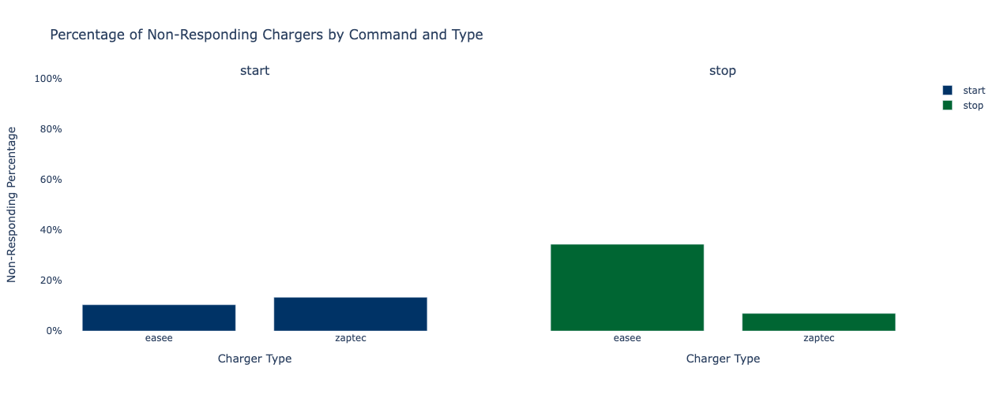

In [29]:
# Process the data
df_grouped = df_commands.groupby(['type', 'command', 'status']).size().unstack(fill_value=0)
df_grouped['total'] = df_grouped.sum(axis=1)
df_grouped['non_responding_percentage'] = df_grouped['did_not_respond'] / df_grouped['total'] * 100

# Prepare data for plotting
charger_types = df_grouped.index.get_level_values('type').unique()
commands = df_grouped.index.get_level_values('command').unique()

# Create subplots
fig = make_subplots(rows=1, cols=len(commands), 
                    subplot_titles=commands,
                    shared_yaxes=True)

# Color scheme
colors = {'start': '#003366', 'stop': '#006633'}

# Add traces for each command
for i, command in enumerate(commands, start=1):
    y_data = df_grouped.loc[(slice(None), command), 'non_responding_percentage']
    fig.add_trace(
        go.Bar(
            x=charger_types,
            y=y_data,
            name=command,
            marker_color=colors[command]
        ),
        row=1, col=i
    )

# Update layout
fig.update_layout(
    title_text="Percentage of Non-Responding Chargers by Command and Type",
    height=500,
    width=len(commands) * 400,  # Adjust width based on number of commands
    showlegend=True,
    plot_bgcolor='#ffffff',
    paper_bgcolor='#ffffff',
)

# Update y-axes
fig.update_yaxes(title_text="Non-Responding Percentage", range=[0, 100], ticksuffix="%", row=1, col=1)

# Update x-axes
for i in range(1, len(commands) + 1):
    fig.update_xaxes(title_text="Charger Type", row=1, col=i)

# Show the figure
fig.show()

In [30]:
df_grouped

status          did_not_respond  did_respond  did_respond_with_delay  total  \
type   command                                                                
easee  start                 55           47                     428    530   
       stop                 246          400                      70    716   
zaptec start                 36            2                     232    270   
       stop                  20          157                     111    288   

status          non_responding_percentage  
type   command                             
easee  start                    10.377358  
       stop                     34.357542  
zaptec start                    13.333333  
       stop                      6.944444

In [197]:
# Filter for stop commands
stop_commands = df_commands[df_commands['command'] == 'stop']

# Group by external_id and check if all statuses are 'did_not_respond'
never_responded = stop_commands.groupby('external_id').filter(
    lambda x: (x['status'] == 'did_not_respond').all()
)

# Get unique list of chargers that never responded
chargers_never_responded = never_responded['external_id'].unique()

# Print summary
print(f"Number of chargers that never responded to stop commands: {len(chargers_never_responded)}")

never_responded

Number of chargers that never responded to stop commands: 155


,event_publish_time,command_time,external_id,type,command,reason,status,reaction_time_seconds
1,2024-03-14 21:18:07.388000+00:00,2024-03-14 21:13:30.668000+00:00,0f636fb6-5b0b-4125-97af-e62bc0183ce3,easee,stop,stop,did_not_respond,NaN
38,2024-04-14 10:59:24.065000+00:00,2024-04-14 10:59:16.533000+00:00,a3dc702b-81c7-4eef-a48f-450c640d1589,zaptec,stop,stop,did_not_respond,NaN
48,2024-03-07 02:32:01.058000+00:00,2024-03-07 02:31:29.839000+00:00,225af063-46d9-4276-8ad3-09bcab9fda54,easee,stop,stop,did_not_respond,NaN
54,2024-03-01 12:45:10.522000+00:00,2024-03-01 12:45:02.492000+00:00,7f685f28-1464-4433-9fcb-3a8209f0de84,zaptec,stop,stop,did_not_respond,NaN
63,2024-03-14 21:18:11.957000+00:00,2024-03-14 21:13:30.668000+00:00,f7e0ce57-dbab-40ff-9810-d08972a7e81e,easee,stop,stop,did_not_respond,NaN
...,...,...,...,...,...,...,...,...
1751,2024-03-07 02:31:31.300000+00:00,2024-03-07 02:31:29.839000+00:00,8c2a15a3-2b94-4bcf-b21f-88b755b16d80,easee,stop,stop,did_not_respond,NaN
1752,2024-03-14 21:18:10.047000+00:00,2024-03-14 21:13:30.668000+00:00,a42b76e4-b151-4392-a551-78c6f5ecd1fe,easee,stop,stop,did_not_respond,NaN
1775,2024-03-14 21:17:47.941000+00:00,2024-03-14 21:13:30.668000+00:00,c2c59b11-830f-4f3e-ab27-67b12d146a68,easee,stop,stop,did_not_respond,NaN
1787,2024-03-07 02:32:33.697000+00:00,2024-03-07 02:31:29.839000+00:00,32594a8d-d141-4c85-88fb-5ceb2d4f263d,easee,stop,stop,did_not_respond,NaN


## Price and Charging

In [ ]:
df_agg['weighted_power'] = df_agg['avg_n_chargers'] * df_agg['avg_power_kw']

weighted_avg_df = df_agg.groupby('time').apply(
    lambda x: pd.Series({
        'avg_n_chargers': x['avg_n_chargers'].mean(),
        'weighted_avg_power_kw': x['weighted_power'].sum() / x['avg_n_chargers'].sum(),
        'avg_price': x['avg_price'].mean()
    })
).reset_index()

weighted_avg_df.head()

In [208]:
df = load_or_run_query('./csv/energy_prices_1d.csv', './sql/energy_prices_1d.sql')
df.head()

Loaded DataFrame from ./csv/energy_prices_1d.csv


,event_date,region,avg_price
0,2023-10-31 09:00:00+00:00,SE2,42.62
1,2023-10-31 09:00:00+00:00,SE3,90.12
2,2023-10-31 09:00:00+00:00,SE4,90.77
3,2023-10-31 10:00:00+00:00,SE1,39.42
4,2023-10-31 10:00:00+00:00,SE2,39.42


/var/folders/h7/6tr60rps7rg1tsw4q4rzdnc40000gn/T/ipykernel_58851/3123186763.py:3: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



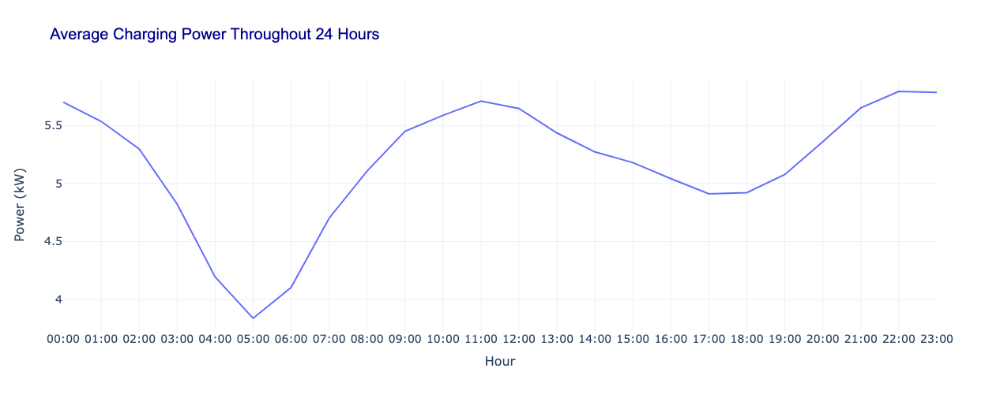

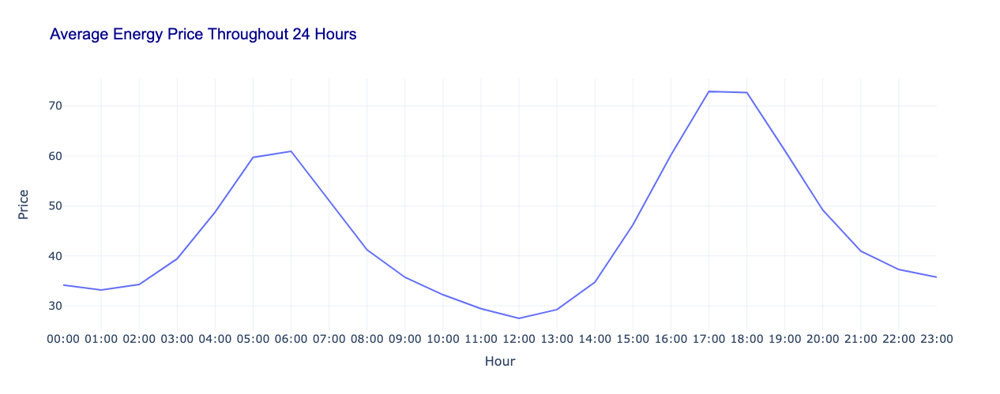

In [214]:
df_agg['weighted_power'] = df_agg['avg_n_chargers'] * df_agg['avg_power_kw']

weighted_avg_df = df_agg.groupby('time_hourly').apply(
    lambda x: pd.Series({
        'avg_n_chargers': x['avg_n_chargers'].mean(),
        'weighted_avg_power_kw': x['weighted_power'].sum() / x['avg_n_chargers'].sum(),
        'avg_price': x['avg_price'].mean()
    })
).reset_index()

weighted_avg_df['time_hourly'] = weighted_avg_df['time_hourly'].astype(str)

fig = px.line(weighted_avg_df, x='time_hourly', y='weighted_avg_power_kw', title='Average Charging Power Throughout 24 Hours', labels={'time_hourly': 'Time (Hourly)', 'Value': 'Value'})

fig.update_layout(
    xaxis_title="Hour",
    yaxis_title="Power (kW)",
    width=1000,
    height=500,
    template='plotly_white',
    title_font=dict(size=20, family='Arial', color='darkblue'),
    xaxis=dict(
        title_font=dict(size=16),
        tickfont=dict(size=14),
    ),
    yaxis=dict(
        title_font=dict(size=16),
        tickfont=dict(size=14),
    )
)

fig.show()

fig = px.line(weighted_avg_df, x='time_hourly', y='avg_price', title='Average Energy Price Throughout 24 Hours', labels={'time_hourly': 'Time (Hourly)', 'Value': 'Value'})

fig.update_layout(
    xaxis_title="Hour",
    yaxis_title="Price",
    width=1000,
    height=500,
    template='plotly_white',
    title_font=dict(size=20, family='Arial', color='darkblue'),
    xaxis=dict(
        title_font=dict(size=16),
        tickfont=dict(size=14),
    ),
    yaxis=dict(
        title_font=dict(size=16),
        tickfont=dict(size=14),
    )
)

fig.show()

**Negative correlation between charging power and energy price (smart charging)**

## Segmentation

### Draft

In [113]:
q = '''

WITH charging_events AS (
  SELECT
    ds.external_id,
    ds.charge_power,
    ds.type AS charger_type,
    DATE(ds.event_publish_time) AS event_date,
    EXTRACT(HOUR FROM ds.event_publish_time) AS hour,
    TIMESTAMP_DIFF(LEAD(ds.event_publish_time) OVER (PARTITION BY ds.external_id ORDER BY ds.event_publish_time), ds.event_publish_time, MILLISECOND) / 1000.0 AS duration_seconds,
    (ds.charge_power * TIMESTAMP_DIFF(LEAD(ds.event_publish_time) OVER (PARTITION BY ds.external_id ORDER BY ds.event_publish_time), ds.event_publish_time, MILLISECOND) / 1000.0) / 3600000 AS energy_kwh
  FROM `fever-data-prod.fever.device_state` ds
  INNER JOIN `fever-data-prod.fever.assets` a ON ds.asset_id = a.id
  WHERE a.organization_id = '90d4188b-f6e6-4150-93d9-c3e23610d084'
    AND ds.event_publish_time >= '2024-05-15 00:00:00'
    AND ds.event_publish_time < '2024-06-01 00:00:00'
    AND a.id IN ('98b95ea6-16e8-45de-83b1-f5676d373e8d') -- SE3 bidding zone
),
session_starts AS (
  SELECT
    external_id,
    charger_type,
    event_date,
    hour,
    charge_power,
    duration_seconds,
    energy_kwh,
    CASE
      WHEN charge_power > 0 AND LAG(charge_power) OVER (PARTITION BY external_id ORDER BY event_date, hour) <= 0 THEN 1
      ELSE 0
    END AS is_session_start
  FROM charging_events
),
charging_sessions AS (
  SELECT
    external_id,
    charger_type,
    event_date,
    hour,
    charge_power,
    duration_seconds,
    energy_kwh,
    SUM(is_session_start) OVER (PARTITION BY external_id ORDER BY event_date, hour) AS session_id
  FROM session_starts
),
cumulative_charging AS (
  SELECT
    external_id,
    charger_type,
    event_date,
    hour,
    charge_power,
    duration_seconds,
    energy_kwh,
    session_id,
    SUM(duration_seconds) OVER (PARTITION BY external_id, event_date, hour ORDER BY event_date, hour ROWS BETWEEN UNBOUNDED PRECEDING AND CURRENT ROW) AS cumulative_duration_seconds
  FROM charging_sessions
),
limited_charging AS (
  SELECT
    external_id,
    charger_type,
    event_date,
    hour,
    charge_power,
    CASE 
      WHEN cumulative_duration_seconds <= 72000 THEN duration_seconds
      WHEN cumulative_duration_seconds - duration_seconds < 72000 THEN 72000 - (cumulative_duration_seconds - duration_seconds)
      ELSE 0
    END AS adjusted_duration_seconds,
    CASE 
      WHEN cumulative_duration_seconds <= 72000 THEN energy_kwh
      WHEN cumulative_duration_seconds - duration_seconds < 72000 THEN (72000 - (cumulative_duration_seconds - duration_seconds)) * (charge_power / 3600000)
      ELSE 0
    END AS adjusted_energy_kwh,
    session_id
  FROM cumulative_charging
)
SELECT
  external_id,
  charger_type,
  event_date,
  hour,
  EXTRACT(DAYOFWEEK FROM event_date) AS day_of_week,
  session_id,
  charge_power,
  adjusted_duration_seconds AS duration_seconds,
  adjusted_energy_kwh AS energy_kwh
FROM limited_charging
ORDER BY external_id, event_date, hour;

'''

df_seg = bq_run(q)

In [115]:
segmentation_df = df_seg

In [116]:
def categorize_time_of_day(hour):
    if 5 <= hour < 12:
        return 'Morning'
    elif 12 <= hour < 17:
        return 'Afternoon'
    elif 17 <= hour < 21:
        return 'Evening'
    else:
        return 'Night'

segmentation_df['time_of_day'] = segmentation_df['hour'].apply(categorize_time_of_day)

# Step 2: One-Hot Encode the 'time_of_day' Feature
encoder = OneHotEncoder(sparse_output=False)
time_of_day_encoded = encoder.fit_transform(segmentation_df[['time_of_day']])

# Convert the encoded features to a DataFrame with appropriate column names
time_of_day_encoded_df = pd.DataFrame(time_of_day_encoded, 
                                      columns=encoder.get_feature_names_out(['time_of_day']))

# Add the encoded time_of_day back to the segmentation_df
segmentation_df = pd.concat([segmentation_df, time_of_day_encoded_df], axis=1)

# Step 3: Aggregate Data by 'external_id' and Calculate New Features
aggregated_df = segmentation_df.groupby('external_id').agg({
    'charge_power': ['mean', 'median', 'max', 'min', 'std', 'var'],
    'duration_seconds': ['mean', 'median', 'std', 'var'],
    'energy_kwh': ['mean', 'median', 'sum'],
    'time_of_day_Morning': 'mean',
    'time_of_day_Afternoon': 'mean',
    'time_of_day_Evening': 'mean',
    'time_of_day_Night': 'mean',
    'session_id': 'nunique'  # Charging Frequency
}).reset_index()

# Flatten multi-level columns
aggregated_df.columns = ['_'.join(col).strip() for col in aggregated_df.columns.values]

# Renaming columns for clarity
aggregated_df.rename(columns={
    'charge_power_mean': 'mean_power',
    'charge_power_median': 'median_power',
    'charge_power_max': 'max_power',
    'charge_power_min': 'min_power',
    'charge_power_std': 'std_power',
    'charge_power_var': 'var_power',
    'duration_seconds_mean': 'mean_duration',
    'duration_seconds_median': 'median_duration',
    'duration_seconds_std': 'std_duration',
    'duration_seconds_var': 'var_duration',
    'energy_kwh_mean': 'mean_energy',
    'energy_kwh_median': 'median_energy',
    'energy_kwh_sum': 'total_energy',
    'session_id_nunique': 'charging_frequency'
}, inplace=True)

# Calculate Power Instability (defined as std_power / mean_power)
aggregated_df['power_instability'] = aggregated_df['std_power'] / aggregated_df['mean_power']

# Step 4: Select Features for Clustering
features = aggregated_df.drop('external_id_', axis=1)  # Drop external_id column

# Handle NaN values by replacing them with 0
features = features.fillna(0)

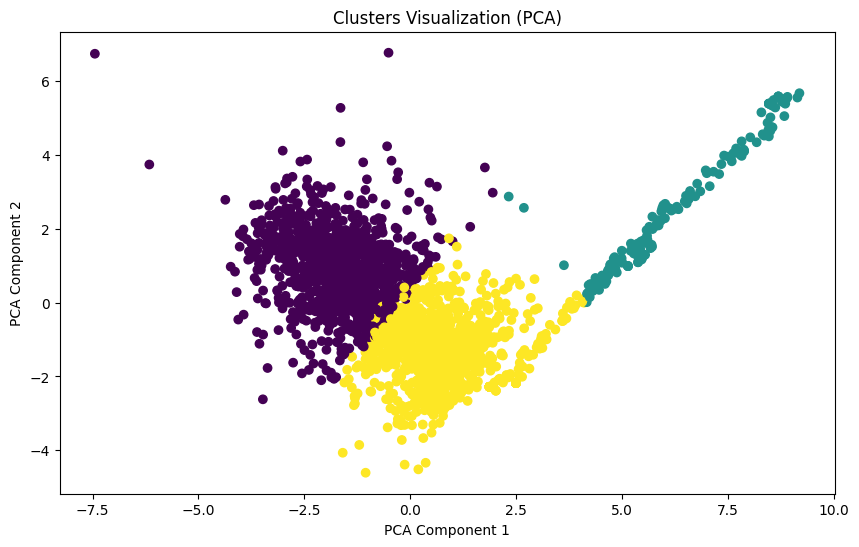

In [162]:
# Step 5: Standardize the Features
scaler = StandardScaler()
scaled_features = scaler.fit_transform(features)

# Step 7: Apply K-Means Clustering with the Optimal Number of Clusters (e.g., K=3)
optimal_clusters = 3  # Change this number based on the elbow plot
kmeans = KMeans(n_clusters=optimal_clusters, init='k-means++', max_iter=300, n_init=10, random_state=42)
aggregated_df['cluster'] = kmeans.fit_predict(scaled_features)

# Optionally, you can visualize the clusters if you reduce dimensionality (e.g., using PCA)
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
pca_components = pca.fit_transform(scaled_features)

plt.figure(figsize=(10, 6))
plt.scatter(pca_components[:, 0], pca_components[:, 1], c=aggregated_df['cluster'], cmap='viridis')
plt.title('Clusters Visualization (PCA)')
plt.xlabel('PCA Component 1')
plt.ylabel('PCA Component 2')
plt.show()


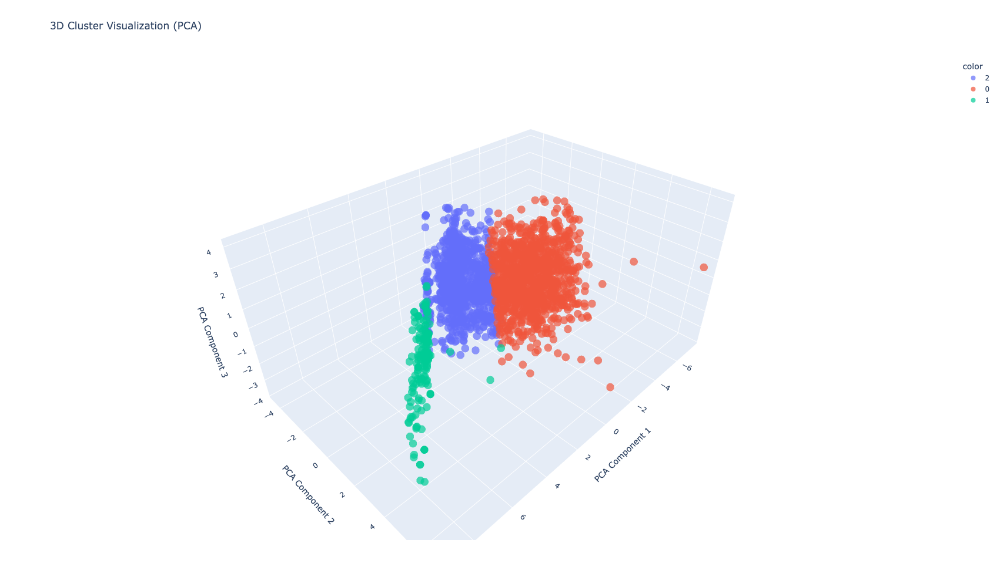

In [161]:
import plotly.express as px
from sklearn.decomposition import PCA

# Step 1: Apply PCA to reduce the dimensionality to 3 components
pca = PCA(n_components=3)
pca_components = pca.fit_transform(scaled_features)

# Add the PCA components to the aggregated dataframe for plotting
aggregated_df['PCA1'] = pca_components[:, 0]
aggregated_df['PCA2'] = pca_components[:, 1]
aggregated_df['PCA3'] = pca_components[:, 2]

# Step 2: Create a 3D scatter plot using Plotly
fig = px.scatter_3d(
    aggregated_df, 
    x='PCA1', 
    y='PCA2', 
    z='PCA3', 
    color=aggregated_df['cluster'].astype(str),  # Convert cluster labels to string for coloring
    title='3D Cluster Visualization (PCA)',
    labels={'PCA1': 'PCA Component 1', 'PCA2': 'PCA Component 2', 'PCA3': 'PCA Component 3'},
    opacity=0.7
)

fig.update_layout(height=1000)

# Show the plot
fig.show()


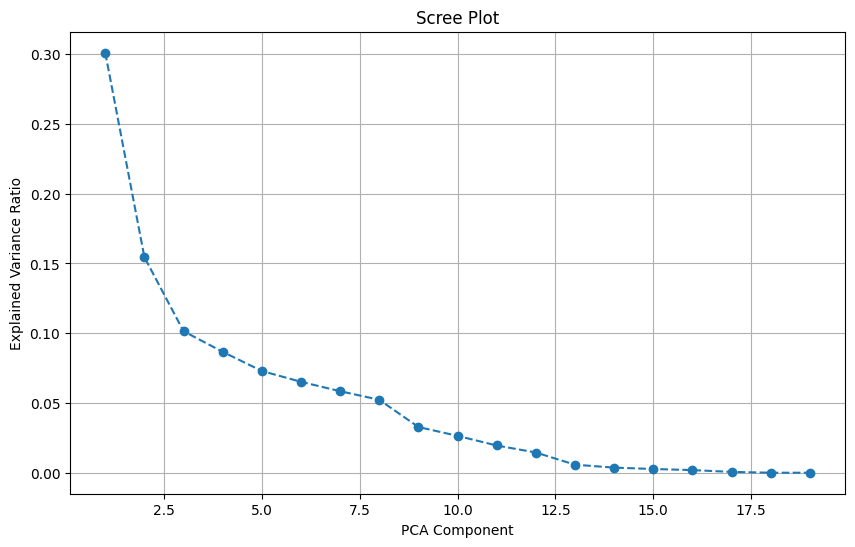

,PCA Component,Explained Variance Ratio
0,1,3.009850e-01
1,2,1.544759e-01
2,3,1.013999e-01
3,4,8.664074e-02
4,5,7.291023e-02
5,6,6.515480e-02
6,7,5.841710e-02
7,8,5.227278e-02
8,9,3.277275e-02
9,10,2.640502e-02


In [159]:
# Step 1: Fit PCA on the scaled features
pca = PCA()
pca.fit(scaled_features)

# Step 2: Calculate the explained variance ratio for each component
explained_variance_ratio = pca.explained_variance_ratio_

# Step 3: Create a scree plot
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(explained_variance_ratio) + 1), explained_variance_ratio, marker='o', linestyle='--')
plt.title('Scree Plot')
plt.xlabel('PCA Component')
plt.ylabel('Explained Variance Ratio')
plt.grid(True)
plt.show()

# Optionally, display the explained variance ratio for each component in a table

explained_variance_df = pd.DataFrame({
    'PCA Component': range(1, len(explained_variance_ratio) + 1),
    'Explained Variance Ratio': explained_variance_ratio
})
explained_variance_df

In [163]:
aggregated_df

,external_id_,mean_power,median_power,max_power,min_power,std_power,var_power,mean_duration,median_duration,std_duration,...,time_of_day_Morning_mean,time_of_day_Afternoon_mean,time_of_day_Evening_mean,time_of_day_Night_mean,charging_frequency,power_instability,cluster,PCA1,PCA2,PCA3
0,000e8afc-ce79-44c7-8362-0250ed280fd9,1333.342340,819.000006,3608.999968,0.0,1405.177245,1.974523e+06,1071.791936,57.6875,5462.372728,...,0.053235,0.209664,0.160524,0.576577,45,1.053876,2,0.420540,-2.251570,1.303232
1,003d0e2d-27bb-4094-86f8-510e9bb0023e,2045.085894,1626.999974,5410.999775,0.0,1971.550287,3.887011e+06,1914.035447,900.2240,8404.770755,...,0.192229,0.323108,0.194274,0.290389,19,0.964043,2,-0.008234,-0.796101,-0.106236
2,0058d431-e006-44dc-bcc9-64fa408d48eb,2458.749525,3440.000057,4103.000164,0.0,1791.883976,3.210848e+06,1946.361532,899.2610,8259.673885,...,0.080374,0.205607,0.220561,0.493458,28,0.728779,2,-0.424078,-0.572632,1.388924
3,00741b37-6307-4107-87e3-fe128e4fb523,4674.982451,7116.000175,7334.000111,0.0,3411.584000,1.163891e+07,4508.335766,151.6400,15413.882461,...,0.397661,0.538012,0.035088,0.029240,5,0.729753,0,-0.547854,1.415800,-1.653322
4,0077d0ee-0b5b-4275-94b2-acc28d0e6425,1117.658044,0.000000,2855.999947,0.0,1305.808452,1.705136e+06,3453.248303,52.2560,11852.302508,...,0.074713,0.270115,0.545977,0.109195,13,1.168343,2,1.442361,-1.236626,-0.787726
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2245,ff2ce35b-dbf1-42df-bf76-ed066f6acc56,1504.140473,1075.999975,3726.000071,0.0,1142.387150,1.305048e+06,254.808033,5.9910,2694.553211,...,0.018889,0.005502,0.087475,0.888135,33,0.759495,2,0.225593,-2.224608,3.048790
2246,ff89ed7d-dfd7-418b-b368-d05f4bf8c72f,1216.277289,0.000000,10713.828000,0.0,3009.479282,9.056966e+06,7055.725911,719.8740,18608.553203,...,0.400000,0.111111,0.155556,0.333333,2,2.474336,2,0.648898,0.307443,-1.274949
2247,ffb9bcf4-8559-4a03-8827-b1ce4448c9f0,8395.245313,11251.000404,11536.000252,0.0,4665.781979,2.176952e+07,674.433334,11.0680,5645.788679,...,0.145022,0.050505,0.081530,0.722944,22,0.555765,0,-3.949418,1.792584,2.660260
2248,ffd029b0-7540-4c57-a2ac-d9b67bb862dd,1957.948912,977.492000,10417.364000,0.0,3092.580966,9.564057e+06,2851.853002,20.9350,9488.575321,...,0.593429,0.123203,0.053388,0.229979,45,1.579500,0,-1.052155,-0.861230,-0.874937


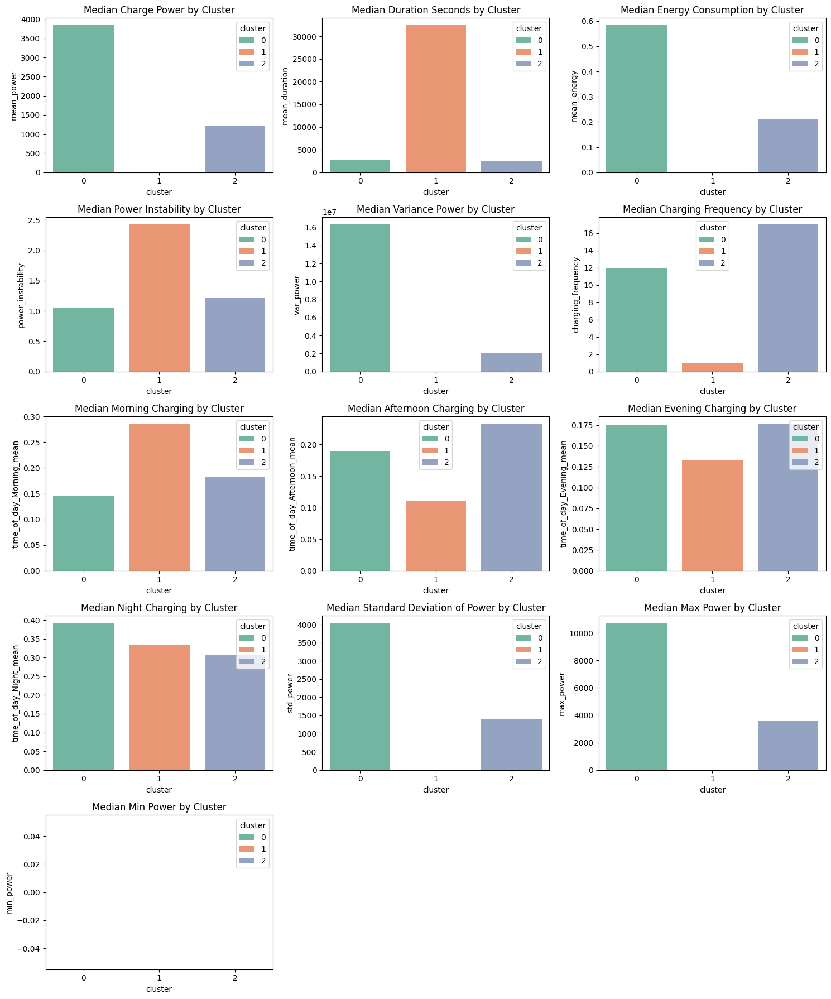

In [177]:
import matplotlib.pyplot as plt
import seaborn as sns

# Step 1: Summarize Cluster Statistics
# Calculate the median for each cluster for various features
cluster_summary = aggregated_df.groupby('cluster').agg({
    'mean_power': 'median',
    'mean_duration': 'median',
    'mean_energy': 'median',
    'power_instability': 'median',
    'var_power': 'median',
    'charging_frequency': 'median',
    'time_of_day_Morning_mean': 'median',
    'time_of_day_Afternoon_mean': 'median',
    'time_of_day_Evening_mean': 'median',
    'time_of_day_Night_mean': 'median',
    'std_power': 'median',  # Adding more features
    'max_power': 'median',
    'min_power': 'median'
}).reset_index()

# Step 2: Plot Cluster Statistics with Different Colors and Adjust Layout
fig, axs = plt.subplots(5, 3, figsize=(15, 18))  # 5 rows and 3 plots per row

# Plotting median power
sns.barplot(x='cluster', y='mean_power', data=cluster_summary, ax=axs[0, 0], hue='cluster', palette='Set2', dodge=False)
axs[0, 0].set_title('Median Charge Power by Cluster')

# Plotting median duration
sns.barplot(x='cluster', y='mean_duration', data=cluster_summary, ax=axs[0, 1], hue='cluster', palette='Set2', dodge=False)
axs[0, 1].set_title('Median Duration Seconds by Cluster')

# Plotting median energy
sns.barplot(x='cluster', y='mean_energy', data=cluster_summary, ax=axs[0, 2], hue='cluster', palette='Set2', dodge=False)
axs[0, 2].set_title('Median Energy Consumption by Cluster')

# Plotting median power instability
sns.barplot(x='cluster', y='power_instability', data=cluster_summary, ax=axs[1, 0], hue='cluster', palette='Set2', dodge=False)
axs[1, 0].set_title('Median Power Instability by Cluster')

# Plotting median variance power
sns.barplot(x='cluster', y='var_power', data=cluster_summary, ax=axs[1, 1], hue='cluster', palette='Set2', dodge=False)
axs[1, 1].set_title('Median Variance Power by Cluster')

# Plotting median charging frequency
sns.barplot(x='cluster', y='charging_frequency', data=cluster_summary, ax=axs[1, 2], hue='cluster', palette='Set2', dodge=False)
axs[1, 2].set_title('Median Charging Frequency by Cluster')

# Plotting median morning charging
sns.barplot(x='cluster', y='time_of_day_Morning_mean', data=cluster_summary, ax=axs[2, 0], hue='cluster', palette='Set2', dodge=False)
axs[2, 0].set_title('Median Morning Charging by Cluster')

# Plotting median afternoon charging
sns.barplot(x='cluster', y='time_of_day_Afternoon_mean', data=cluster_summary, ax=axs[2, 1], hue='cluster', palette='Set2', dodge=False)
axs[2, 1].set_title('Median Afternoon Charging by Cluster')

# Plotting median evening charging
sns.barplot(x='cluster', y='time_of_day_Evening_mean', data=cluster_summary, ax=axs[2, 2], hue='cluster', palette='Set2', dodge=False)
axs[2, 2].set_title('Median Evening Charging by Cluster')

# Plotting median night charging
sns.barplot(x='cluster', y='time_of_day_Night_mean', data=cluster_summary, ax=axs[3, 0], hue='cluster', palette='Set2', dodge=False)
axs[3, 0].set_title('Median Night Charging by Cluster')

# Plotting median std power
sns.barplot(x='cluster', y='std_power', data=cluster_summary, ax=axs[3, 1], hue='cluster', palette='Set2', dodge=False)
axs[3, 1].set_title('Median Standard Deviation of Power by Cluster')

# Plotting median max power
sns.barplot(x='cluster', y='max_power', data=cluster_summary, ax=axs[3, 2], hue='cluster', palette='Set2', dodge=False)
axs[3, 2].set_title('Median Max Power by Cluster')

# Plotting median min power
sns.barplot(x='cluster', y='min_power', data=cluster_summary, ax=axs[4, 0], hue='cluster', palette='Set2', dodge=False)
axs[4, 0].set_title('Median Min Power by Cluster')

# Remove empty plots
axs[4, 1].axis('off')
axs[4, 2].axis('off')

plt.tight_layout()
plt.show()


#### * Cluster 0: High power and energy consumption with stable and consistent charging patterns. Moderate frequency and duration.
#### * Cluster 1: Moderate power but with long, unstable charging sessions and lower frequency. Focuses on morning and afternoon charging.
#### * Cluster 2: Low power with quick, frequent charging sessions. More evening and night charging with low power instability.

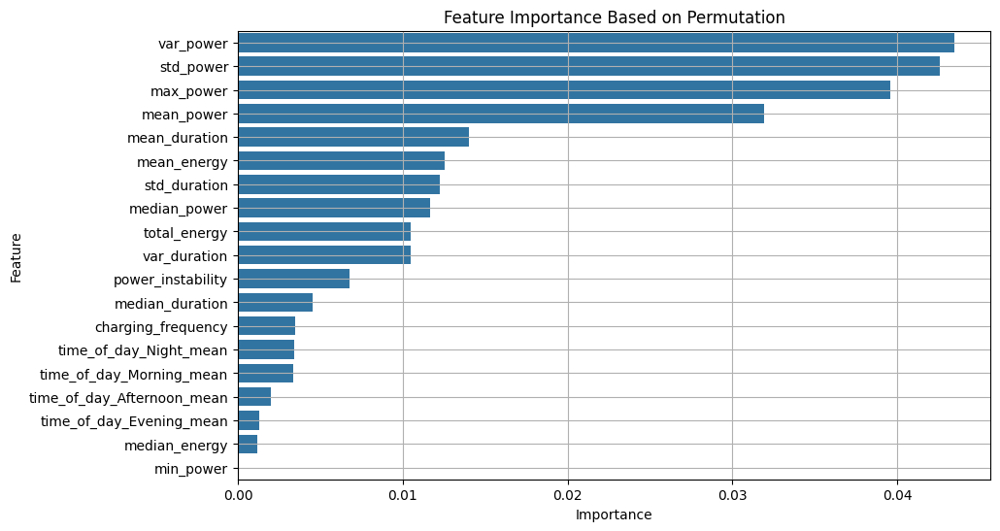

In [175]:
from sklearn.metrics import silhouette_score
import numpy as np

# Calculate the original silhouette score
original_score = silhouette_score(scaled_features, kmeans.labels_)

# Store the results
feature_importance = {}

# Shuffle each feature and calculate the impact on the silhouette score
for i, feature in enumerate(features.columns):
    permuted_features = scaled_features.copy()
    np.random.shuffle(permuted_features[:, i])
    permuted_score = silhouette_score(permuted_features, kmeans.labels_)
    feature_importance[feature] = original_score - permuted_score  # Higher value indicates higher importance

# Convert the results to a DataFrame and display
feature_importance_df = pd.DataFrame(list(feature_importance.items()), columns=['Feature', 'Importance'])
feature_importance_df.sort_values(by='Importance', ascending=False, inplace=True)

# Plot the feature importance
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=feature_importance_df)
plt.title('Feature Importance Based on Permutation')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.grid(True)
plt.show()


In [176]:
original_score

0.214363820552674

In [128]:
cluster_summary

,cluster_,mean_power_mean,mean_power_median,mean_duration_mean,mean_duration_median,mean_energy_mean,mean_energy_median,power_instability_mean,power_instability_median,var_power_mean,var_power_median,charging_frequency_mean,charging_frequency_median
0,0,4174.040350,3839.923179,3350.036273,2655.268183,0.749821,0.582621,1.110587,1.054683,1.664154e+07,1.631389e+07,16.774464,12.0
1,1,19.411816,0.000000,30999.613520,32410.938521,0.011960,0.000000,2.624813,2.425200,1.526985e+05,0.000000e+00,1.051282,1.0
2,2,1268.005081,1226.022014,3102.205347,2450.341528,0.290098,0.209260,1.391990,1.211030,3.048206e+06,2.000481e+06,22.057786,17.0


### With Payloads (TBD)

In [1080]:
df_seg = pd.read_csv('./csv/charger_segmentation_with_payloads.csv')

## Weather

In [179]:
q = '''

  SELECT
    ts AS event_date,
    CASE
      WHEN name = "LULEÅ" THEN "SE1"
      WHEN name = "SUNDSVALL" THEN "S2"
      WHEN name IN ("STOCKHOLM", "GOTHENBURG") THEN "S3"
      WHEN name IN ("MALMÖ", "HELSINGBORG") THEN "S4"
    END
    AS region,
    temperature_2m,
    apparent_temperature,
    precipitation_probability,
    precipitation,
    snowfall,
    wind_speed_10m,
    uv_index,
    direct_radiation_instant,
  FROM
    `fever-data-prod.openmeteo.weather`
'''

df_weather = bq_run(q)

In [180]:
df_weather.head()

,event_date,region,temperature_2m,apparent_temperature,precipitation_probability,precipitation,snowfall,wind_speed_10m,uv_index,direct_radiation_instant
0,2024-08-27 20:00:00+00:00,SE1,11.5,10.320084,11.0,0.0,0.0,10.948973,0.1,0.000000
1,2024-08-27 03:00:00+00:00,SE1,12.0,10.244268,10.0,0.0,0.0,9.957108,0.0,0.000000
2,2024-08-27 11:00:00+00:00,SE1,16.0,13.459000,7.0,0.1,0.0,17.388409,3.3,456.235474
3,2024-08-26 15:00:00+00:00,SE1,18.0,15.952377,19.0,0.0,0.0,12.413476,2.5,218.197250
4,2024-08-24 08:00:00+00:00,SE1,18.0,16.160774,27.0,0.1,0.0,21.794127,2.6,208.903976


GROUP region


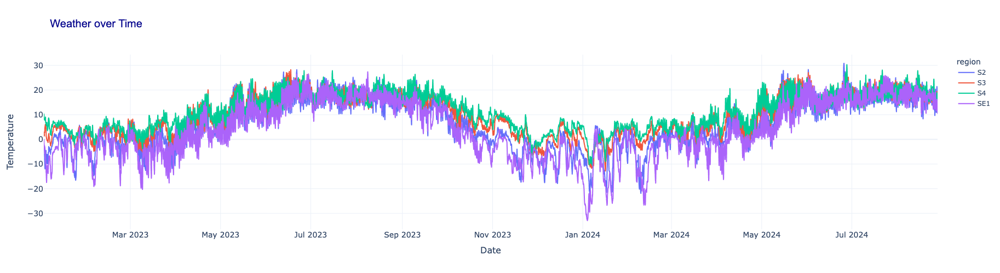

In [181]:
df_weather = df_weather[df_weather['event_date'] > '2023-01-01 10:00:00+00:00']
df_plot = df_weather[df_weather['event_date'] > '2023-01-01 10:00:00+00:00']
lineplot("Weather over Time", "Date", "Temperature", "temperature_2m", df_plot=df_plot, group='region')

Loaded DataFrame from ./csv/energy_prices_1d.csv
GROUP region


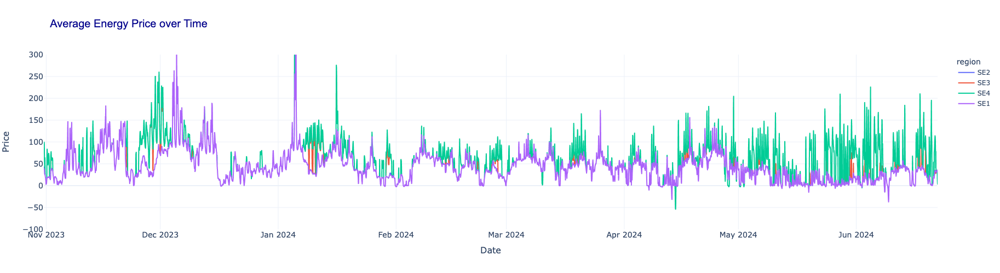

In [184]:
df_prices = load_or_run_query('./csv/energy_prices_1d.csv', './sql/energy_prices_1d.sql')
df_prices.head()

df_prices['event_date'] = pd.to_datetime(df_prices['event_date'])
start_date = pd.to_datetime('2023-01-01').tz_localize('UTC')
df_plot = df_prices[df_prices['event_date'] > start_date]

lineplot('Average Energy Price over Time', 'Date', 'Price', 'avg_price', y_axis_upper_limit=300, y_axis_lower_limit=-100, df_plot=df_plot, group='region')

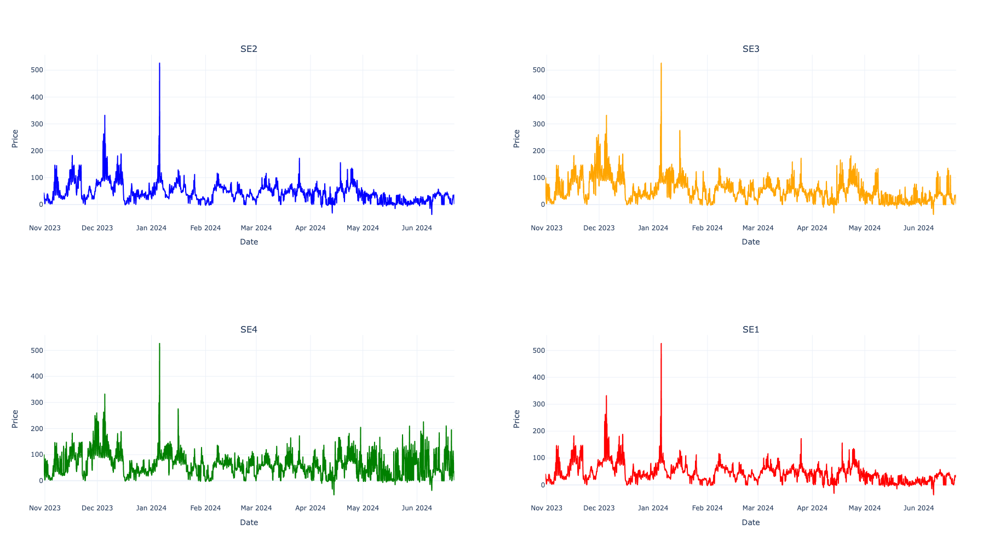

In [185]:
groups = df_plot['region'].unique()
num_groups = min(len(groups), 4)  
fig = sp.make_subplots(rows=2, cols=2, subplot_titles=[f"{group}" for group in groups[:num_groups]])

for i, group in enumerate(groups[:num_groups]):
    group_df = df_plot[df_plot['region'] == group]
    group_df = group_df.groupby('event_date')['avg_price'].mean().reset_index()
    x = group_df['event_date']
    y = group_df['avg_price']

    colors = ['blue', 'orange', 'green', 'red']  # Add more colors if needed

    trace = px.line(group_df, x=x, y=y).data[0]
    trace.update(line=dict(color=colors[i]))
            
    fig.add_trace(
        trace,
        row=(i // 2) + 1,
        col=(i % 2) + 1,
    )


for i in range(1, num_groups + 1):
    fig.update_xaxes(title_text="Date", row=(i // 2) + 1, col=(i % 2) + 1)
    fig.update_yaxes(title_text="Price", row=(i // 2) + 1, col=(i % 2) + 1)
        

fig.update_traces(hovertemplate=f'<b>{"y"}</b>: %{{y}}<br><b>{"x"}</b>: %{{x}}')

fig.update_layout(
    xaxis_title="Date",
    yaxis_title="Price",
    width=1200,
    height=1000,
    template='plotly_white',
    #axis_range=[y_axis_lower_limit, y_axis_upper_limit] if y_axis_lower_limit is not None and y_axis_upper_limit is not None else None
)

In [186]:
df_prices['event_date'] = pd.to_datetime(df_prices['event_date'])
df_weather['event_date'] = pd.to_datetime(df_weather['event_date'])
df_merged = pd.merge(df_prices, df_weather, on=['event_date', 'region'], how='inner')

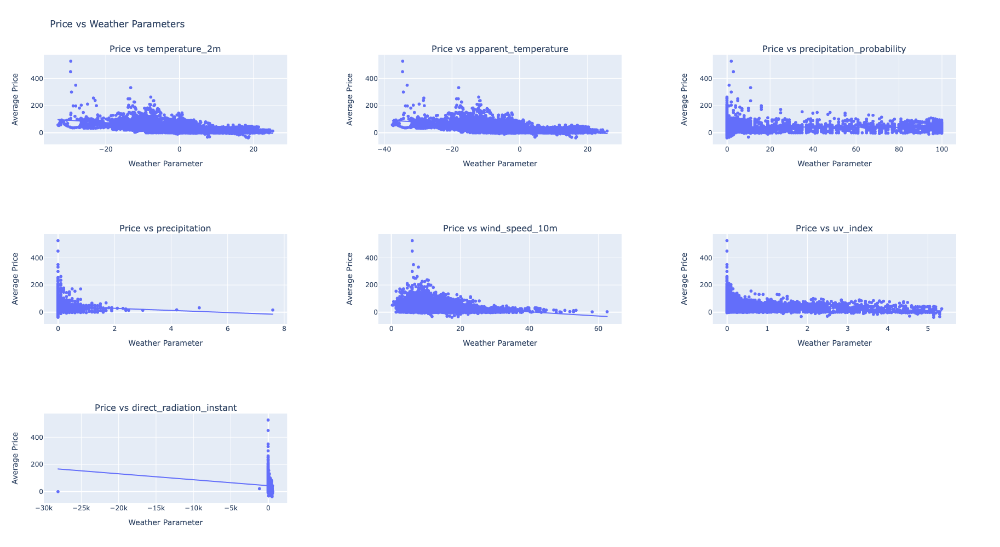

In [187]:
weather_params = ['temperature_2m', 'apparent_temperature', 'precipitation_probability', 'precipitation', 'wind_speed_10m', 'uv_index', 'direct_radiation_instant']

fig = sp.make_subplots(rows=3, cols=3, subplot_titles=[f'Price vs {param}' for param in weather_params], horizontal_spacing=0.1, vertical_spacing=0.2)

for i, param in enumerate(weather_params):
    row = i // 3 + 1
    col = i % 3 + 1
    scatter = px.scatter(df_merged, x=param, y='avg_price', trendline="ols")
    
    for trace in scatter['data']:
        fig.add_trace(trace, row=row, col=col)

fig.update_layout(
    height=1000, 
    width=1500, 
    title_text="Price vs Weather Parameters"
)

for i in range(1, 4):
    for j in range(1, 4):
        fig.update_xaxes(title_text="Weather Parameter", row=i, col=j)
        fig.update_yaxes(title_text="Average Price", row=i, col=j)

fig.show()

In [190]:
import statsmodels.api as sm

regression_results = []

for param in weather_params:
    X = df_merged[[param]]
    y = df_merged['avg_price']
    
    # Add a constant term for the intercept
    X = sm.add_constant(X)
    
    # Fit the regression model
    model = sm.OLS(y, X).fit()
    
    # Store the parameter, coefficient, and p-value
    regression_results.append({
        'Parameter': param,
        'Coefficient': model.params[param],
        'P-Value': model.pvalues[param]
    })

# Convert results to a DataFrame and sort by coefficient
regression_df = pd.DataFrame(regression_results).sort_values(by='Coefficient', ascending=False)

# Display the regression results
regression_df.sort_values(by='Coefficient')


,Parameter,Coefficient,P-Value
3,precipitation,-7.727021,3.455187e-05
5,uv_index,-7.033885,7.414314e-72
0,temperature_2m,-1.743098,0.000000e+00
4,wind_speed_10m,-1.513484,4.082720e-134
1,apparent_temperature,-1.504246,0.000000e+00
2,precipitation_probability,-0.061790,1.234815e-04
6,direct_radiation_instant,-0.004372,2.112245e-04


**Precipication and uv_index have the strongest influence on price.**